In [1]:
import glob
import os
import time
import tensorflow as tf
import numpy as np
import psutil    
import GPUtil
import numpy as np
import torch
import matplotlib.pyplot as plt
import cv2

from object_detection.utils import label_map_util
from object_detection.utils import ops as utils_ops
from object_detection.utils import visualization_utils as viz_utils
from PIL import Image
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator, SamPredictor
import warnings

# Suppress the specific FutureWarning
warnings.filterwarnings("ignore", category=FutureWarning, 
                        message="You are using `torch.load` with `weights_only=False`")
%matplotlib inline


In [2]:

DEBUG = False
IMAGE_DIR = './images/test/'
IMAGE_PATHS = glob.glob(os.path.join(IMAGE_DIR, '*'))

# Load model
PATH_TO_SAVED_MODEL = './exported-models/mask_rcnn_inception_resnet_v2_1024x1024_coco17_gpu-8' + "/saved_model"
SAM_CHECKPOINT = 'sam_vit_h_4b8939.pth'
MODEL_TYPE = 'vit_h'
DEVICE = 'cpu' if torch.cuda.is_available() else 'cpu'

# Load TensorFlow model
print('Loading TensorFlow model...', end='')
start_time = time.time()
detect_fn = tf.saved_model.load(PATH_TO_SAVED_MODEL)
end_time = time.time()
elapsed_time = end_time - start_time
print(f'Done! Took {elapsed_time:.2f} seconds')

# Free up memory if needed
torch.cuda.empty_cache()

# Load SAM model
print('Loading SAM model...', end='')
start_time = time.time()

sam = sam_model_registry[MODEL_TYPE](checkpoint=SAM_CHECKPOINT)
sam.to(DEVICE)
predictor = SamPredictor(sam)

end_time = time.time()
elapsed_time = end_time - start_time
print(f'Done! Took {elapsed_time:.2f} seconds')

# Labels
PATH_TO_LABELS = './annotations/label_map.pbtxt'
category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS, use_display_name=True)

Loading TensorFlow model...Done! Took 9.17 seconds
Loading SAM model...Done! Took 2.57 seconds


In [3]:
def log_hardware_usage():

    ram_usage = psutil.virtual_memory()
    cpu_usage = f"CPU RAM Free: {ram_usage.free / (1024 ** 3):.2f}GB | Used: {ram_usage.used / (1024 ** 3):.2f}GB | Util {ram_usage.percent:3.0f}% | Total {ram_usage.total / (1024 ** 3):.2f}GB"
    
    gpu = GPUtil.getGPUs()[0]
    gpu_usage = f"GPU RAM Free: {gpu.memoryFree / 1024:.2f}GB | Used: {gpu.memoryUsed / 1024:.2f}GB | Util {gpu.memoryUtil * 100:3.0f}% | Total {gpu.memoryTotal / 1024:.2f}GB"
    
    return cpu_usage, gpu_usage

def show_points(coords, labels, ax, marker_size = 375):
    pos_points = coords[labels == 1]
    neg_points = coords[labels == 0]
    ax.scatter(pos_points[:, 0], pos_points[:, 1], color='green', marker='*', s=marker_size, edgecolor='white', linewidth=1.25)
    ax.scatter(neg_points[:, 0], neg_points[:, 1], color='red', marker='*', s=marker_size, edgecolor='white', linewidth=1.25)

def load_image_into_numpy_array(path):
    """Load an image from file into a numpy array."""
    image = Image.open(path)
    if image.mode != "RGB":
        image = image.convert("RGB")
    return np.array(image)

def show_mask(mask, ax):
    color = np.concatenate([np.random.random(3), np.array([0.6])], axis=0)
    h, w = mask.shape[-2:]
    mask_image = mask.reshape(h, w, 1) * color.reshape(1, 1, -1)
    ax.imshow(mask_image)

Running inference for ./images/test/img1724309927.pgm... 
Bounding Box Coordinate: (0.3170013427734375, 319.26142930984497, 1256.9560241699219, 713.6878395080566)


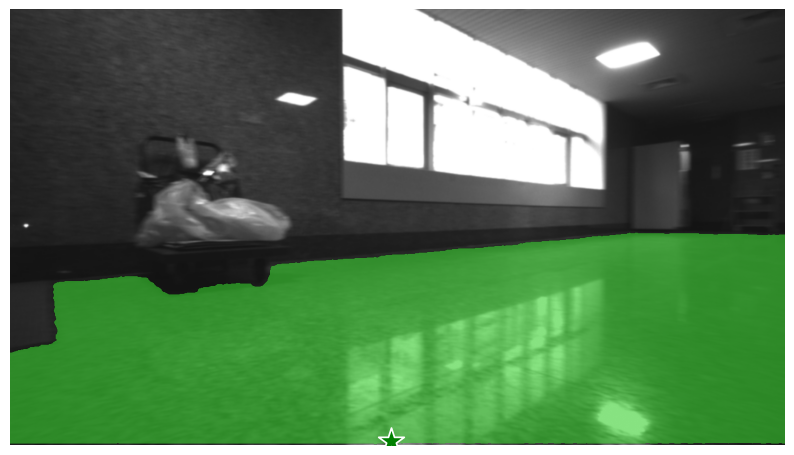

CPU RAM Free: 2.51GB | Used: 12.87GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.22GB | Used: 22.41GB | Util  93% | Total 23.99GB
Took 9.779786586761475 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309934.pgm... 
Bounding Box Coordinate: (24.573707580566406, 217.2497034072876, 1226.3473510742188, 705.4381799697876)


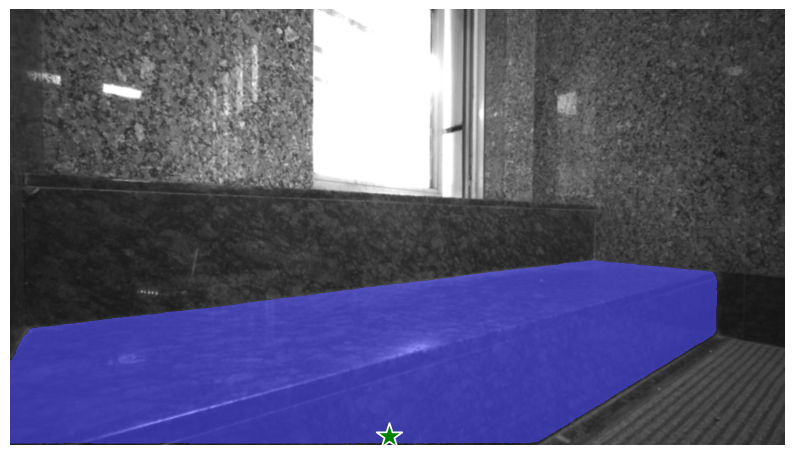

CPU RAM Free: 2.50GB | Used: 12.88GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.22GB | Used: 22.41GB | Util  93% | Total 23.99GB
Took 7.650200843811035 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309909.pgm... 
Bounding Box Coordinate: (2.335968017578125, 407.1601867675781, 1260.6877899169922, 708.6682033538818)


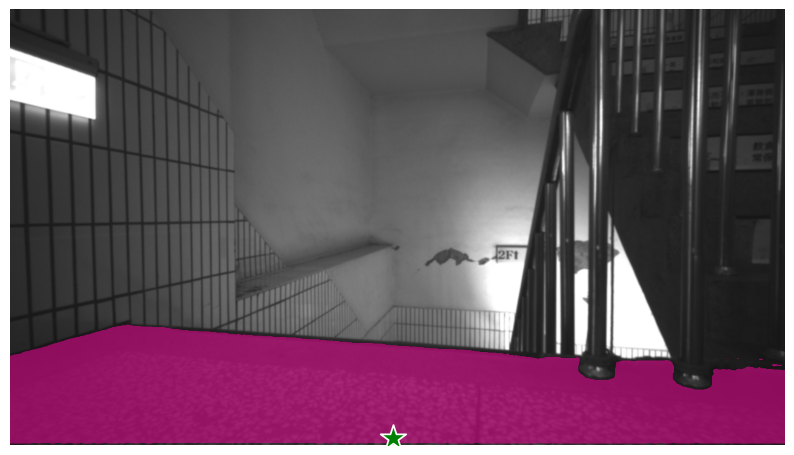

CPU RAM Free: 2.56GB | Used: 12.82GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.22GB | Used: 22.41GB | Util  93% | Total 23.99GB
Took 7.603395223617554 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309894.pgm... 
Bounding Box Coordinate: (42.1727180480957, 580.3793048858643, 404.0556335449219, 712.6674842834473)


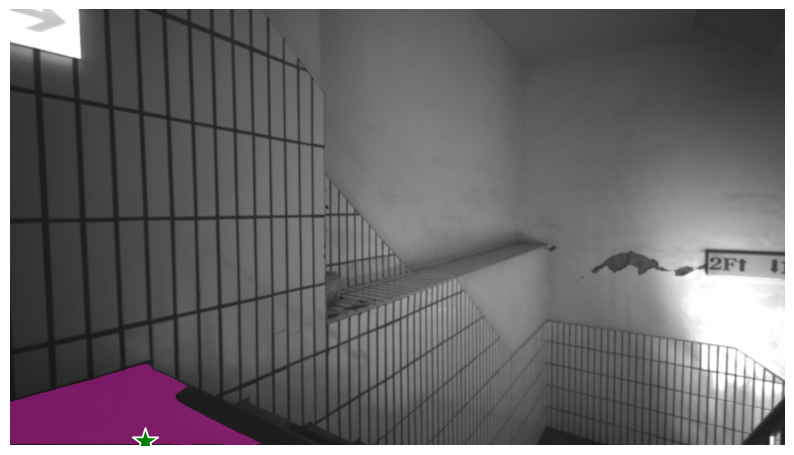

CPU RAM Free: 2.55GB | Used: 12.83GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.22GB | Used: 22.41GB | Util  93% | Total 23.99GB
Took 7.553703308105469 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309898.pgm... 
Bounding Box Coordinate: (398.44322204589844, 91.67216420173645, 1060.1607513427734, 376.4837408065796)


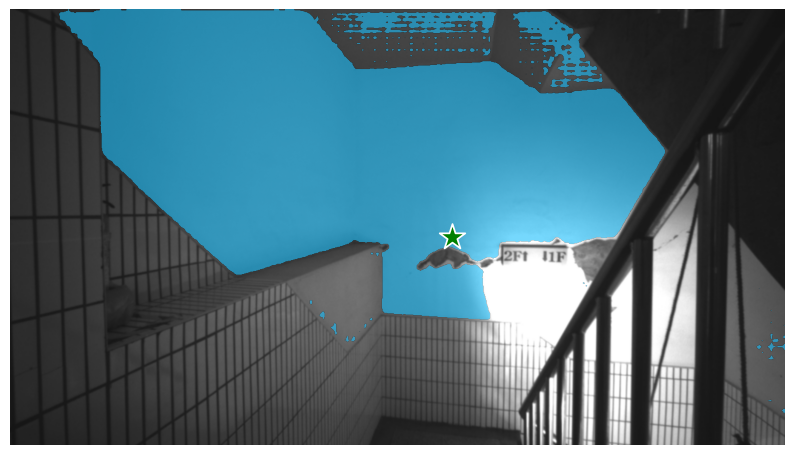

CPU RAM Free: 2.64GB | Used: 12.75GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.26GB | Used: 22.37GB | Util  93% | Total 23.99GB
Took 7.500978231430054 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1723432945.pgm... 
Bounding Box Coordinate: (230.04467010498047, 405.61326026916504, 1221.7713928222656, 706.8564033508301)


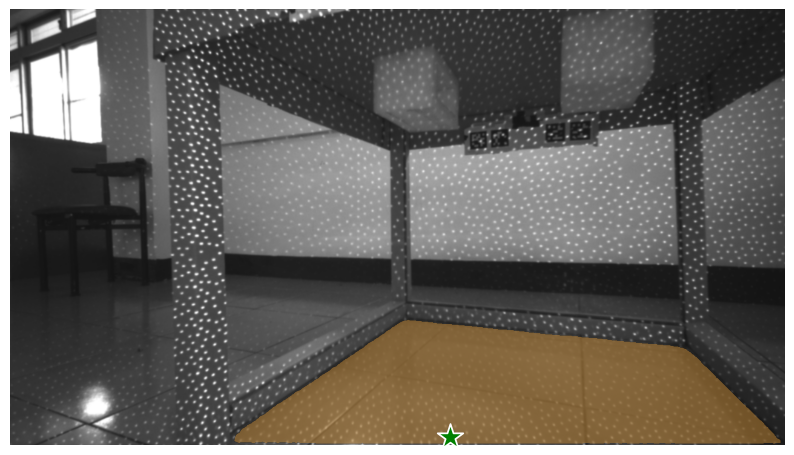

CPU RAM Free: 2.64GB | Used: 12.74GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.26GB | Used: 22.37GB | Util  93% | Total 23.99GB
Took 7.895494222640991 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309839.pgm... 
Bounding Box Coordinate: (0.0, 389.11540031433105, 1278.1790161132812, 711.3839721679688)


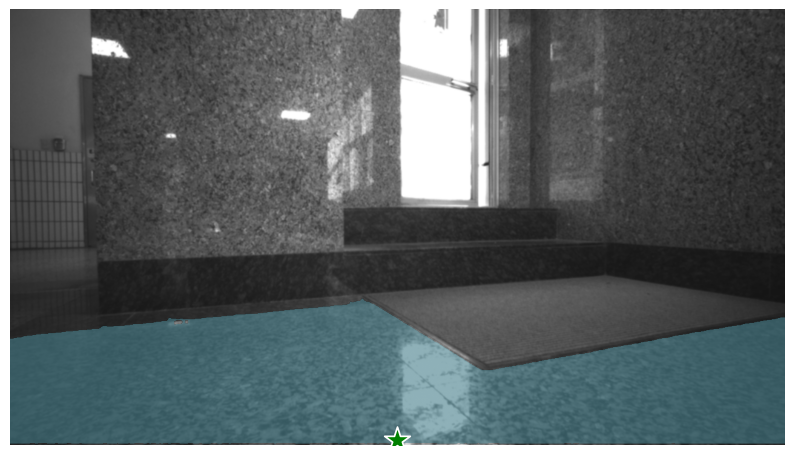

CPU RAM Free: 2.63GB | Used: 12.75GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.26GB | Used: 22.37GB | Util  93% | Total 23.99GB
Took 7.9642720222473145 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309861.pgm... 
Bounding Box Coordinate: (7.0934295654296875, 396.1706829071045, 1268.709487915039, 714.1260051727295)


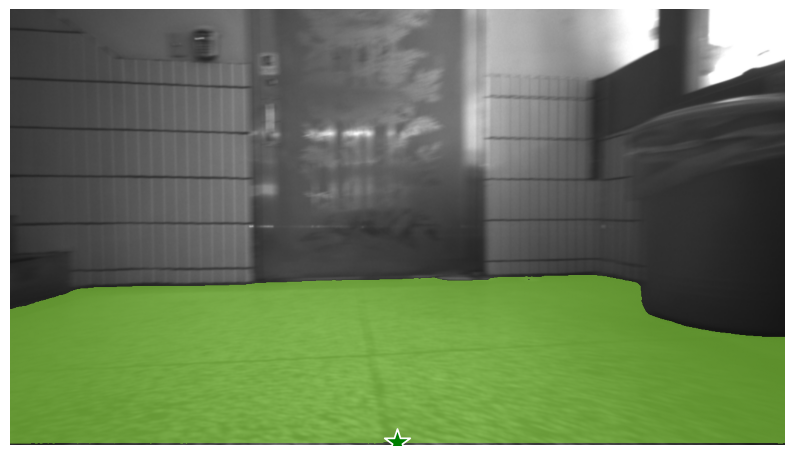

CPU RAM Free: 2.60GB | Used: 12.78GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.26GB | Used: 22.37GB | Util  93% | Total 23.99GB
Took 7.957929372787476 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309895.pgm... 
Bounding Box Coordinate: (762.4314880371094, 72.85314202308655, 1237.7604675292969, 253.6956024169922)


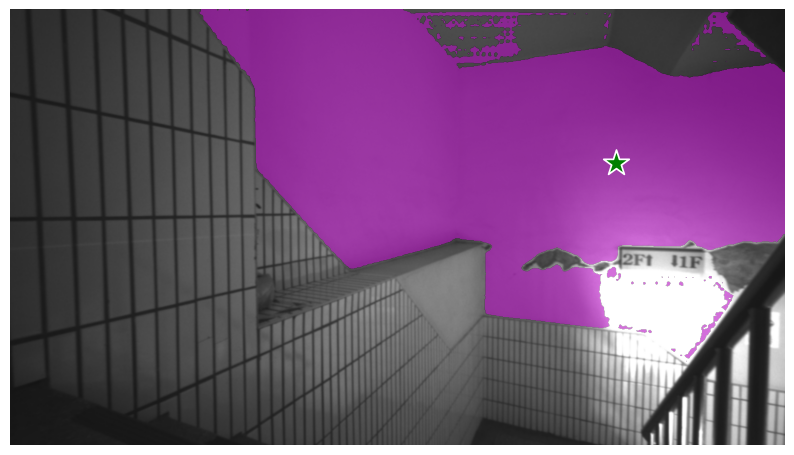

CPU RAM Free: 2.59GB | Used: 12.80GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.26GB | Used: 22.37GB | Util  93% | Total 23.99GB
Took 7.9751081466674805 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309875.pgm... 
Bounding Box Coordinate: (23.27556610107422, 322.6915669441223, 1261.6297912597656, 691.5475559234619)


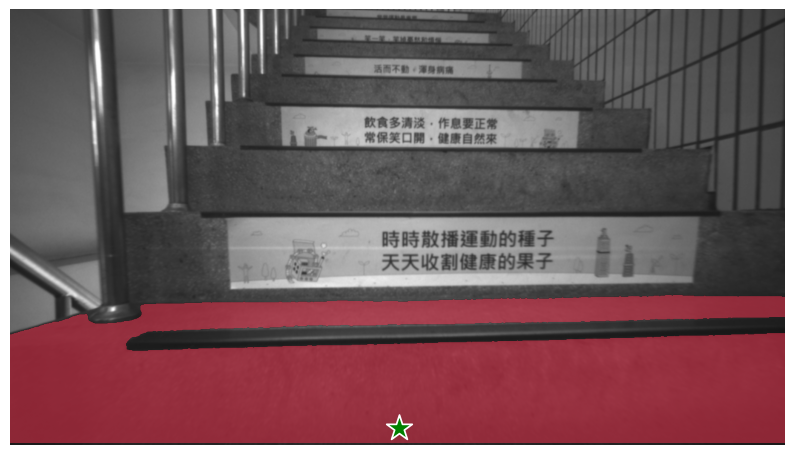

CPU RAM Free: 2.59GB | Used: 12.79GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.26GB | Used: 22.37GB | Util  93% | Total 23.99GB
Took 8.023668766021729 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309849.pgm... 
Bounding Box Coordinate: (156.34075164794922, 393.26136589050293, 1250.2076721191406, 711.1958312988281)


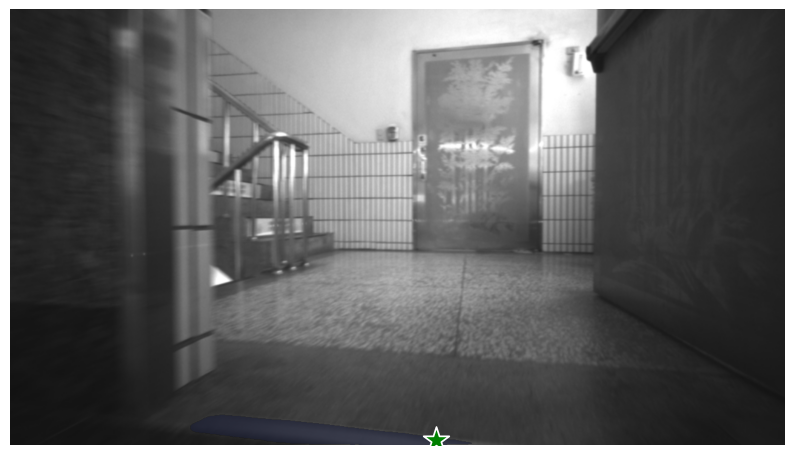

CPU RAM Free: 2.56GB | Used: 12.83GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.26GB | Used: 22.37GB | Util  93% | Total 23.99GB
Took 7.958452463150024 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309846.pgm... 
Bounding Box Coordinate: (9.488716125488281, 287.84250497817993, 1256.5333557128906, 703.3400917053223)


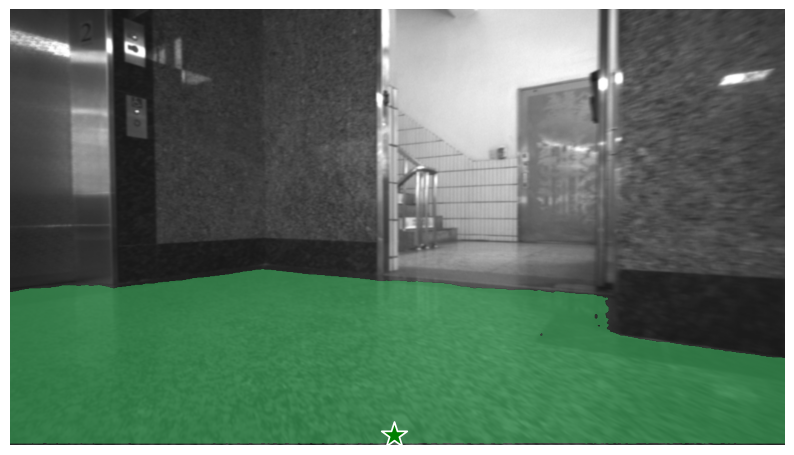

CPU RAM Free: 2.56GB | Used: 12.82GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.26GB | Used: 22.37GB | Util  93% | Total 23.99GB
Took 7.948715925216675 secs to annotate
--------------------------------------------------

Running inference for ./images/test/1722163506@0.29,0.07,-0.84.jpg... 
Bounding Box Coordinate: (8.850581645965576, 165.84880828857422, 705.5944347381592, 1210.1507568359375)


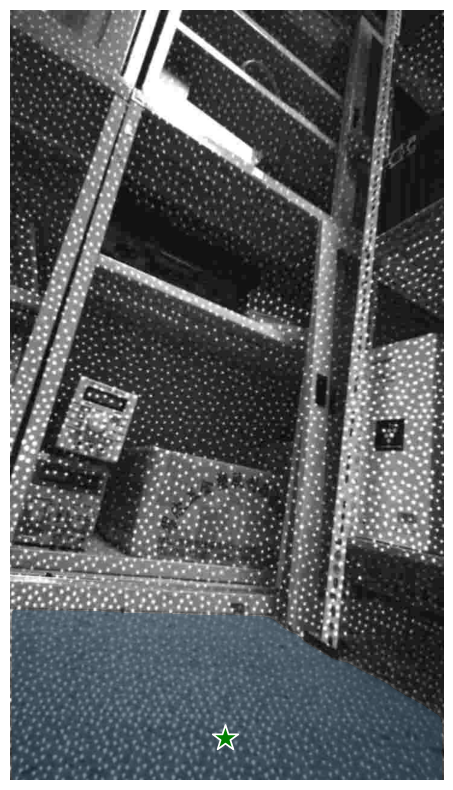

CPU RAM Free: 2.54GB | Used: 12.85GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.26GB | Used: 22.37GB | Util  93% | Total 23.99GB
Took 7.963316917419434 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309873.pgm... 
Bounding Box Coordinate: (20.049057006835938, 198.29242944717407, 1258.6161041259766, 691.8135452270508)


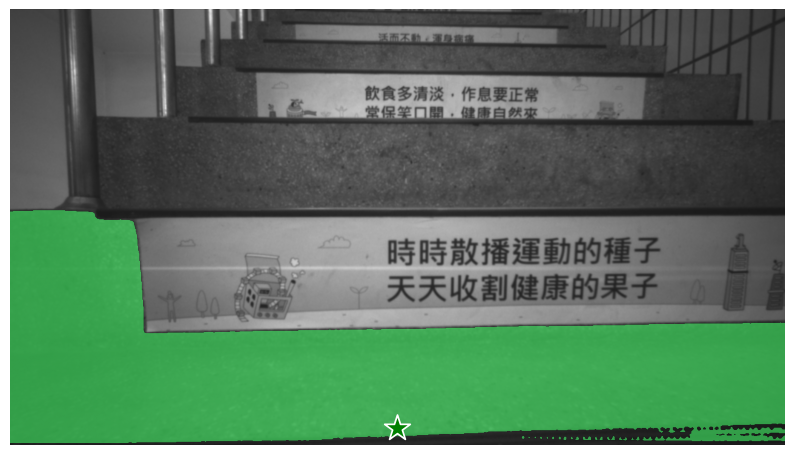

CPU RAM Free: 2.59GB | Used: 12.79GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.26GB | Used: 22.37GB | Util  93% | Total 23.99GB
Took 7.973103284835815 secs to annotate
--------------------------------------------------

Running inference for ./images/test/1722163238@-0.01,0.29,-0.75.jpg... 
Bounding Box Coordinate: (23.535890579223633, 514.1869735717773, 705.4001140594482, 1231.217041015625)


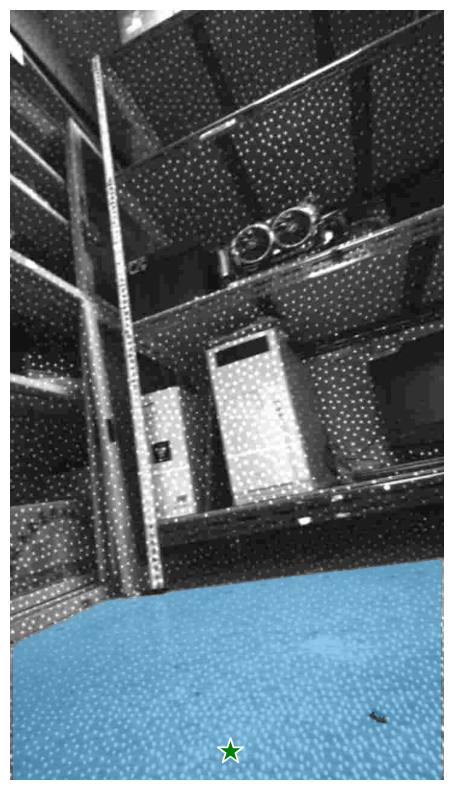

CPU RAM Free: 2.55GB | Used: 12.83GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.26GB | Used: 22.37GB | Util  93% | Total 23.99GB
Took 7.887213706970215 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309851.pgm... 
Bounding Box Coordinate: (22.084197998046875, 399.945387840271, 1276.8470764160156, 714.1392660140991)


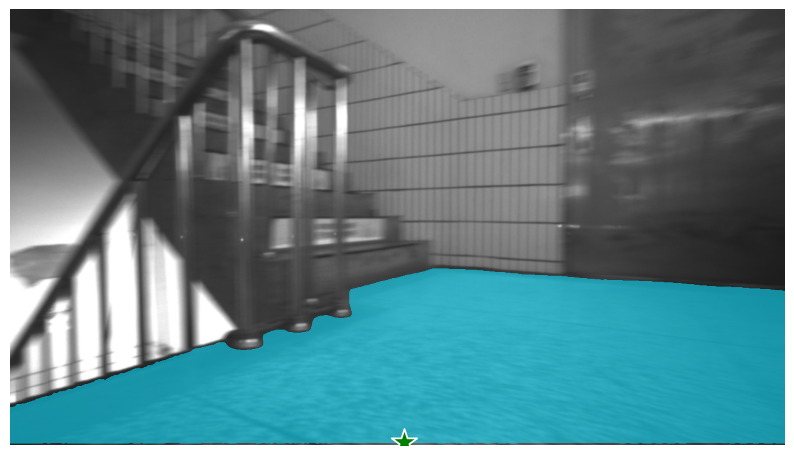

CPU RAM Free: 2.53GB | Used: 12.85GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.26GB | Used: 22.37GB | Util  93% | Total 23.99GB
Took 7.9426093101501465 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309838.pgm... 
Bounding Box Coordinate: (12.293548583984375, 382.06239223480225, 1066.94580078125, 710.3772211074829)


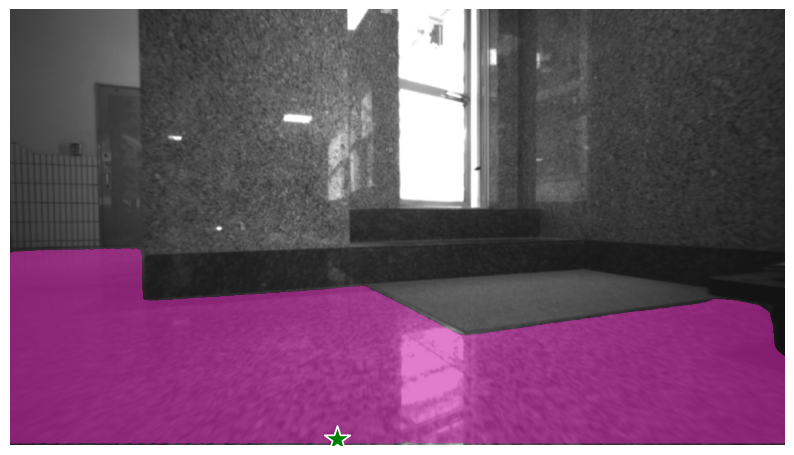

CPU RAM Free: 2.51GB | Used: 12.87GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.26GB | Used: 22.37GB | Util  93% | Total 23.99GB
Took 8.054980516433716 secs to annotate
--------------------------------------------------

Running inference for ./images/test/1722163223@-0.44,0.67,-0.03.jpg... 
Bounding Box Coordinate: (12.307798862457275, 554.1970443725586, 706.038007736206, 1240.2499389648438)


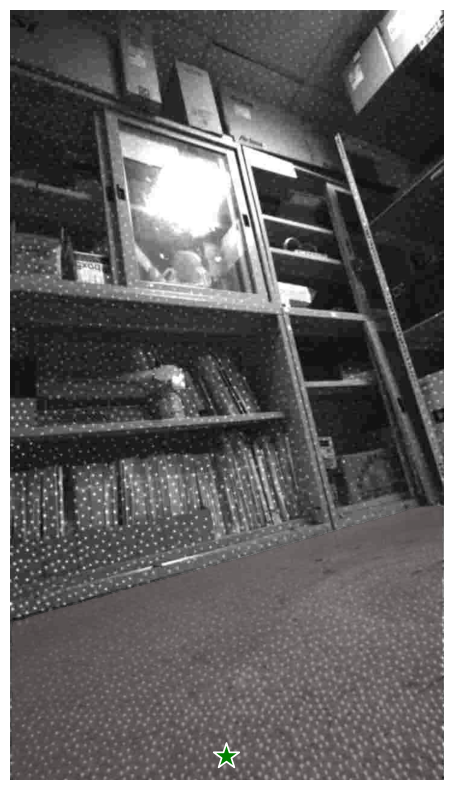

CPU RAM Free: 2.49GB | Used: 12.89GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.26GB | Used: 22.37GB | Util  93% | Total 23.99GB
Took 8.02463150024414 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309869.pgm... 
Bounding Box Coordinate: (20.475196838378906, 238.5141921043396, 1265.2992248535156, 698.6784553527832)


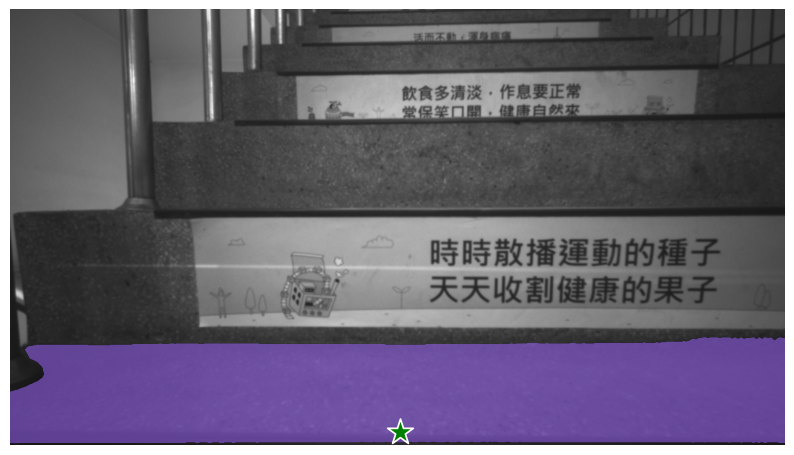

CPU RAM Free: 2.52GB | Used: 12.87GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.26GB | Used: 22.37GB | Util  93% | Total 23.99GB
Took 7.972126722335815 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309931.pgm... 
Bounding Box Coordinate: (12.903785705566406, 135.54283618927002, 1230.0352478027344, 703.1069326400757)


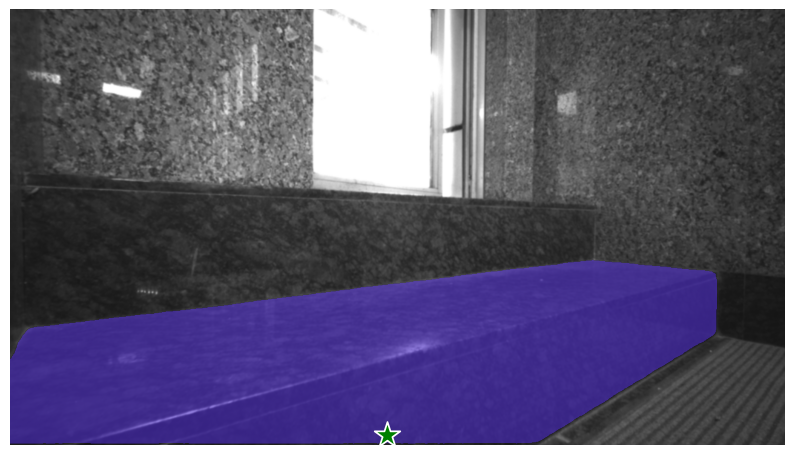

CPU RAM Free: 2.52GB | Used: 12.86GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.26GB | Used: 22.37GB | Util  93% | Total 23.99GB
Took 8.06455659866333 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309878.pgm... 
Bounding Box Coordinate: (44.62837219238281, 397.60860443115234, 1265.4483795166016, 712.5535011291504)


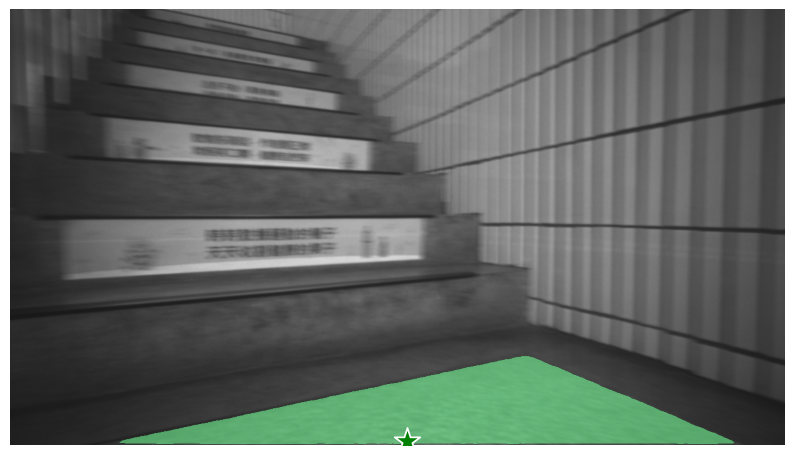

CPU RAM Free: 2.69GB | Used: 12.95GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.26GB | Used: 22.37GB | Util  93% | Total 23.99GB
Took 7.989301681518555 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309886.pgm... 
Bounding Box Coordinate: (7.360267639160156, 359.88258361816406, 1252.1310424804688, 712.5324726104736)


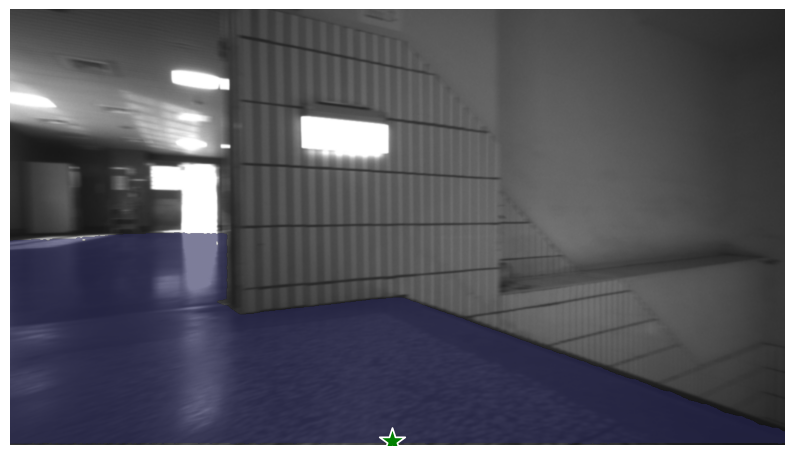

CPU RAM Free: 2.69GB | Used: 12.95GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.24GB | Used: 22.39GB | Util  93% | Total 23.99GB
Took 8.0105881690979 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309887.pgm... 
Bounding Box Coordinate: (12.194061279296875, 355.0992822647095, 1233.9521789550781, 713.9406538009644)


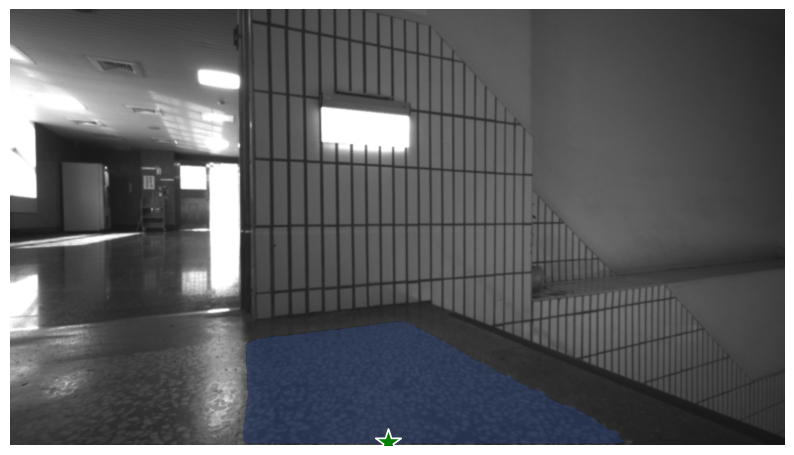

CPU RAM Free: 2.71GB | Used: 12.92GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.25GB | Used: 22.37GB | Util  93% | Total 23.99GB
Took 7.953356742858887 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309913.pgm... 
Bounding Box Coordinate: (3.2680130004882812, 409.29749965667725, 1264.3342590332031, 708.410325050354)


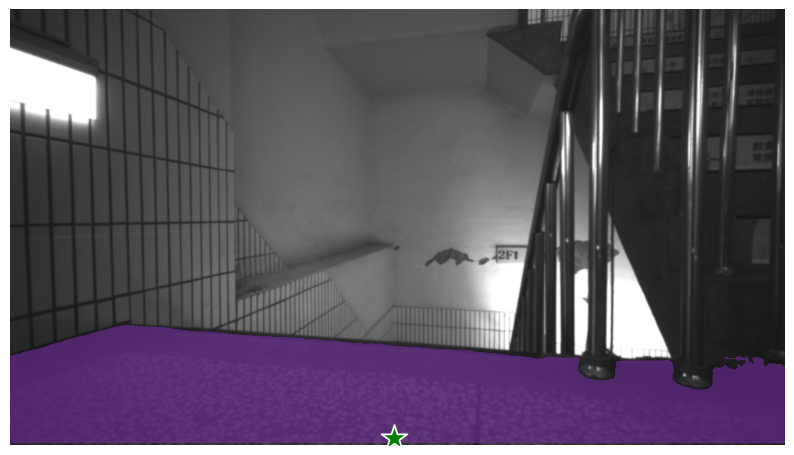

CPU RAM Free: 2.71GB | Used: 12.92GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.25GB | Used: 22.37GB | Util  93% | Total 23.99GB
Took 7.93967866897583 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309893.pgm... 
Bounding Box Coordinate: (49.27957534790039, 563.0485010147095, 526.4910888671875, 714.4885110855103)


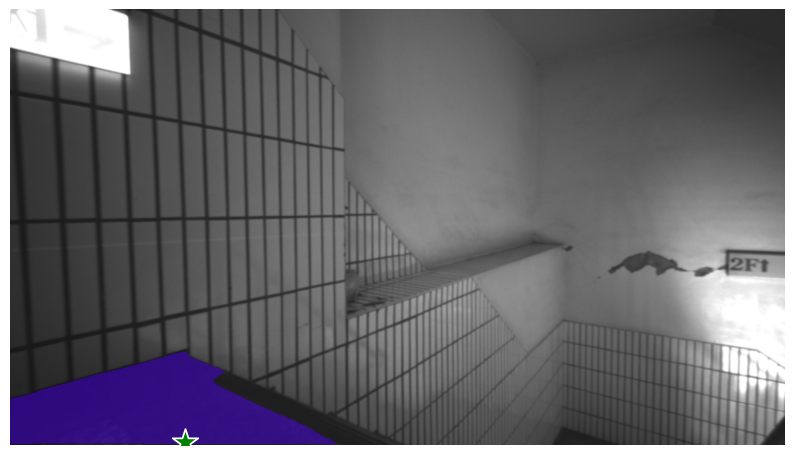

CPU RAM Free: 2.68GB | Used: 12.96GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.25GB | Used: 22.37GB | Util  93% | Total 23.99GB
Took 7.988184213638306 secs to annotate
--------------------------------------------------

Running inference for ./images/test/1722163511@0.28,0.07,0.02.jpg... 
Bounding Box Coordinate: (17.291836738586426, 123.55045318603516, 717.3422956466675, 1215.4145812988281)


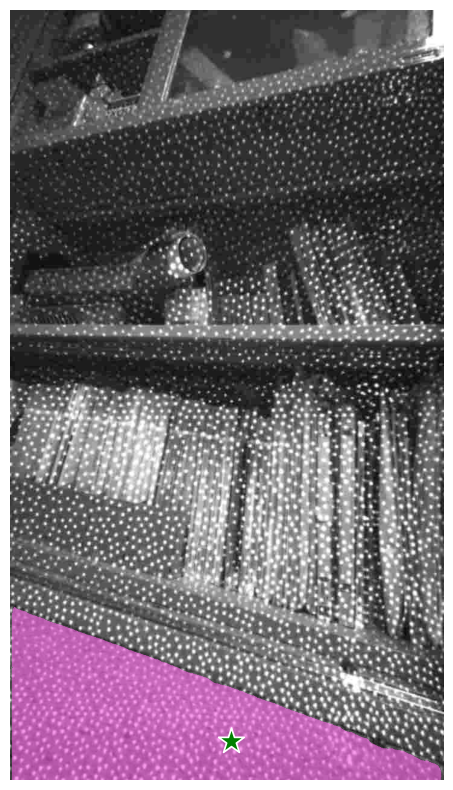

CPU RAM Free: 2.72GB | Used: 12.92GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.24GB | Used: 22.39GB | Util  93% | Total 23.99GB
Took 8.088928699493408 secs to annotate
--------------------------------------------------

Running inference for ./images/test/1722163249@0.29,0.07,0.02.jpg... 
Bounding Box Coordinate: (0.0, 0.0, 720.0, 1275.7485961914062)


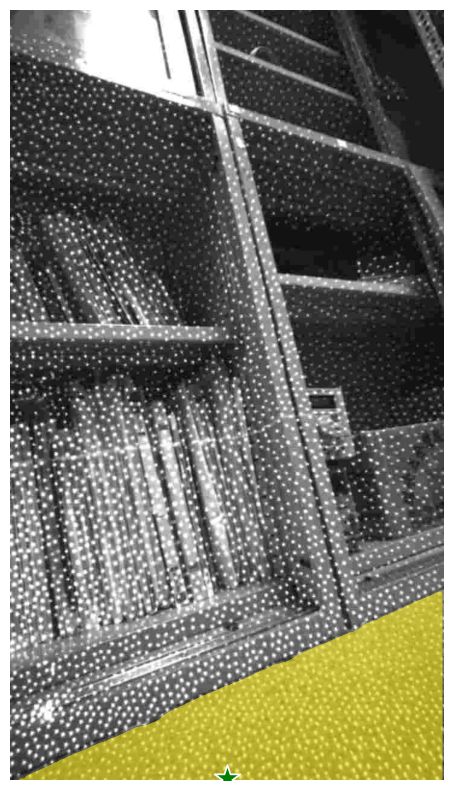

CPU RAM Free: 2.69GB | Used: 12.94GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.25GB | Used: 22.37GB | Util  93% | Total 23.99GB
Took 7.97205376625061 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309860.pgm... 
Bounding Box Coordinate: (27.27428436279297, 399.1957426071167, 1280.0, 713.6958646774292)


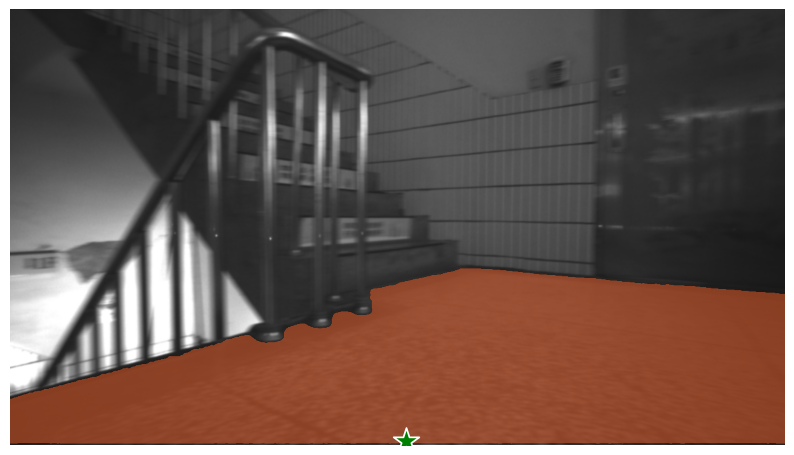

CPU RAM Free: 2.68GB | Used: 12.96GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.25GB | Used: 22.37GB | Util  93% | Total 23.99GB
Took 7.96322226524353 secs to annotate
--------------------------------------------------

Running inference for ./images/test/1722163521@0.29,0.08,0.53.jpg... 
Bounding Box Coordinate: (5.457587242126465, 0.0, 720.0, 1257.1736907958984)


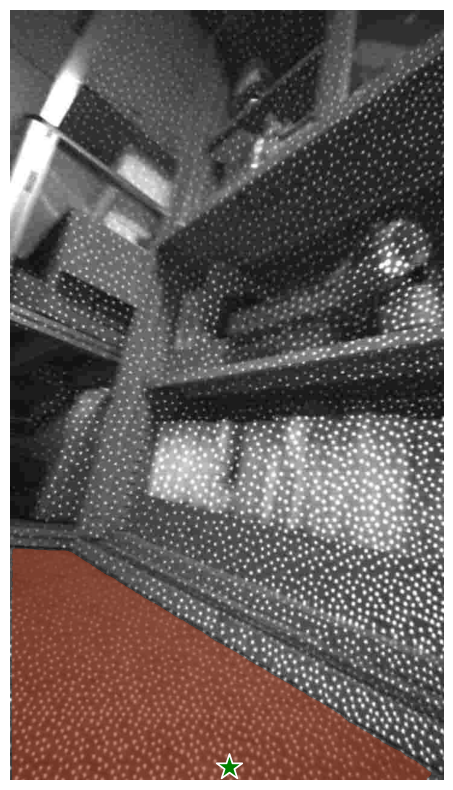

CPU RAM Free: 2.69GB | Used: 12.95GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.25GB | Used: 22.37GB | Util  93% | Total 23.99GB
Took 8.065752983093262 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309858.pgm... 
Bounding Box Coordinate: (190.47473907470703, 529.2008256912231, 1249.6452331542969, 718.2989645004272)


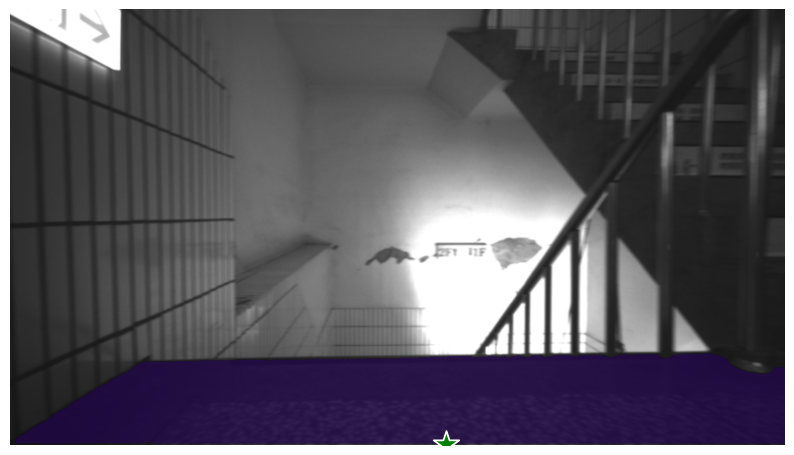

CPU RAM Free: 2.68GB | Used: 12.96GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.25GB | Used: 22.37GB | Util  93% | Total 23.99GB
Took 8.00768494606018 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309900.pgm... 
Bounding Box Coordinate: (399.9244689941406, 90.52571296691895, 1068.1089782714844, 379.7907543182373)


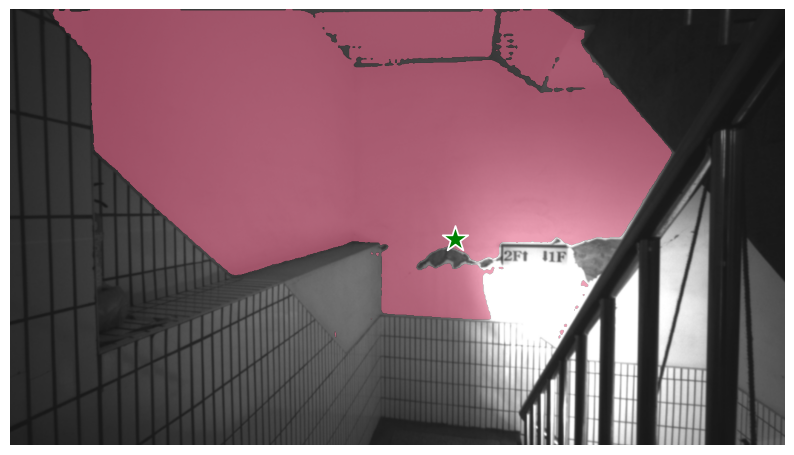

CPU RAM Free: 2.66GB | Used: 12.98GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.25GB | Used: 22.37GB | Util  93% | Total 23.99GB
Took 8.092143535614014 secs to annotate
--------------------------------------------------

Running inference for ./images/test/1722163264@0.21,0.13,2.47.jpg... 
Bounding Box Coordinate: (0.0, 687.8059387207031, 717.3918628692627, 1263.5679626464844)


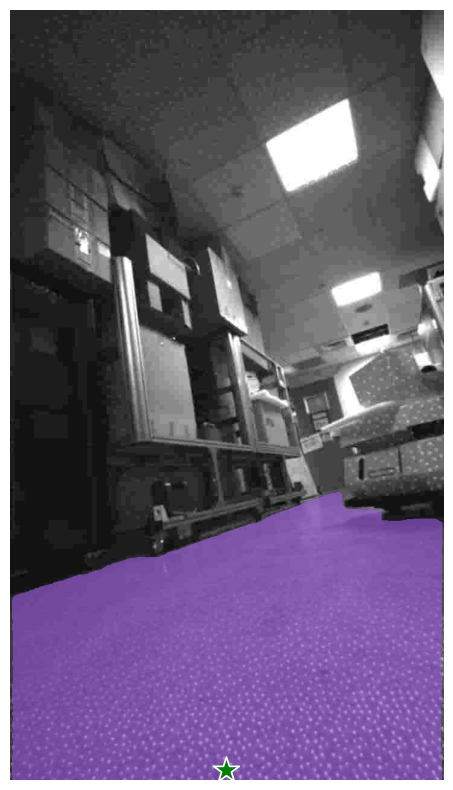

CPU RAM Free: 2.73GB | Used: 12.91GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.25GB | Used: 22.37GB | Util  93% | Total 23.99GB
Took 7.96218204498291 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309906.pgm... 
Bounding Box Coordinate: (3.4461212158203125, 398.3738708496094, 1256.2440490722656, 707.1320056915283)


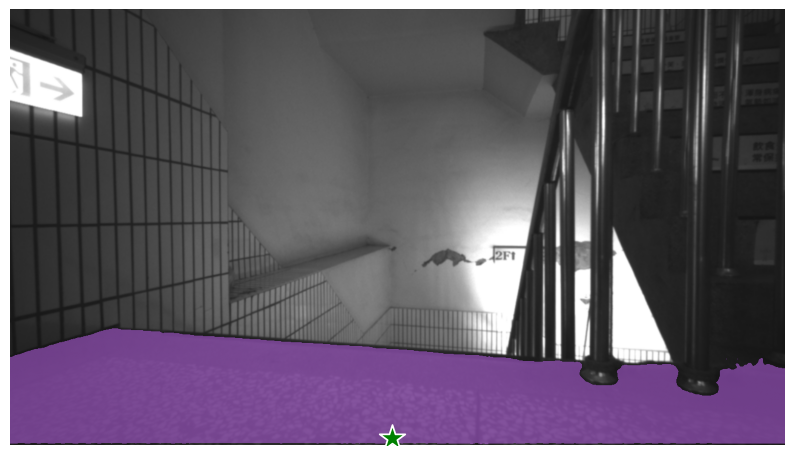

CPU RAM Free: 2.67GB | Used: 12.98GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.25GB | Used: 22.37GB | Util  93% | Total 23.99GB
Took 8.025412559509277 secs to annotate
--------------------------------------------------

Running inference for ./images/test/1722163233@-0.44,0.67,-0.04.jpg... 
Bounding Box Coordinate: (15.210120677947998, 557.9091262817383, 705.2808952331543, 1238.7255859375)


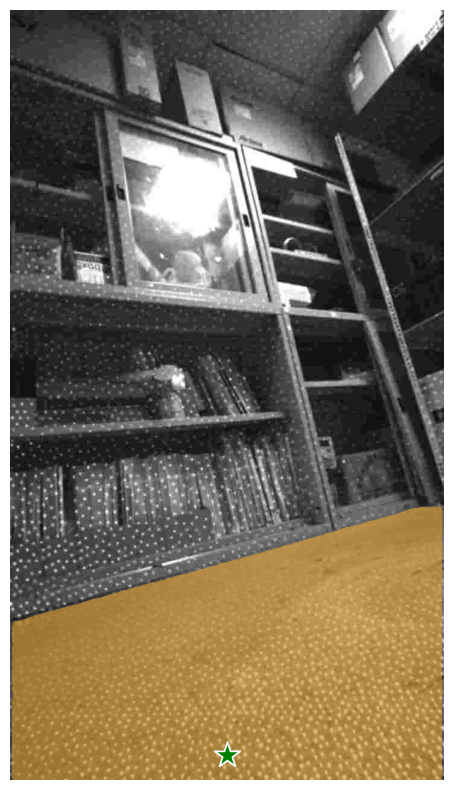

CPU RAM Free: 2.72GB | Used: 12.92GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.26GB | Used: 22.37GB | Util  93% | Total 23.99GB
Took 8.050016403198242 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309921.pgm... 
Bounding Box Coordinate: (19.353675842285156, 354.9132442474365, 937.623291015625, 712.8124523162842)


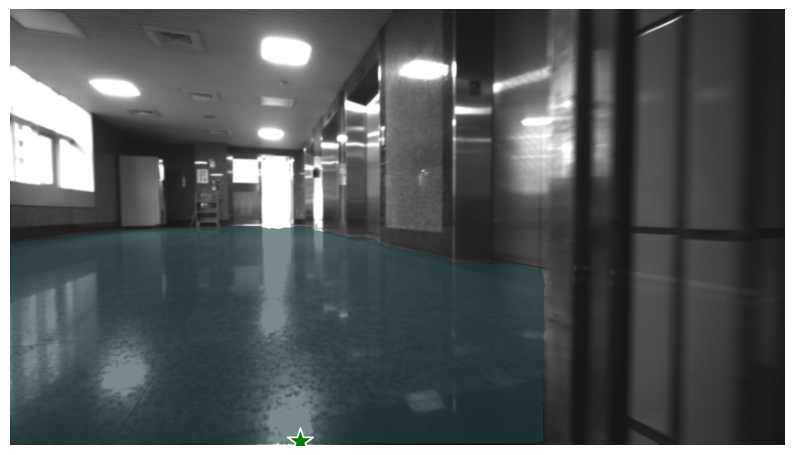

CPU RAM Free: 2.68GB | Used: 12.96GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.26GB | Used: 22.37GB | Util  93% | Total 23.99GB
Took 7.9840593338012695 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309911.pgm... 
Bounding Box Coordinate: (2.8880691528320312, 410.82236766815186, 1262.852783203125, 708.9567232131958)


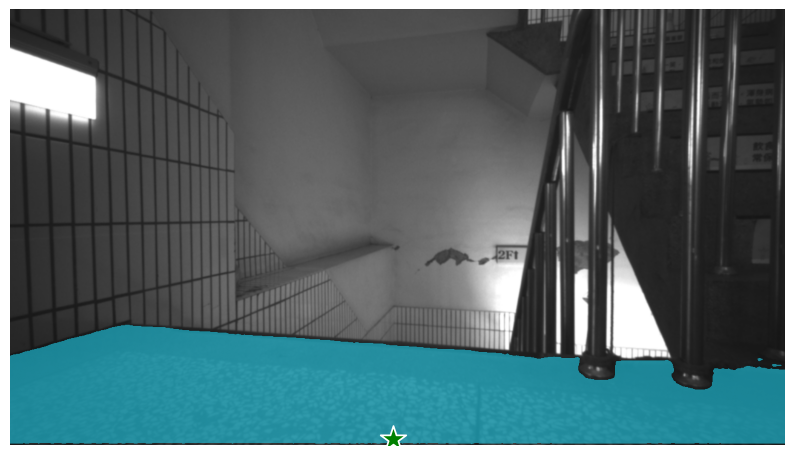

CPU RAM Free: 2.65GB | Used: 12.99GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.26GB | Used: 22.37GB | Util  93% | Total 23.99GB
Took 7.9735376834869385 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309901.pgm... 
Bounding Box Coordinate: (407.98778533935547, 92.04443335533142, 1067.0301818847656, 380.800724029541)


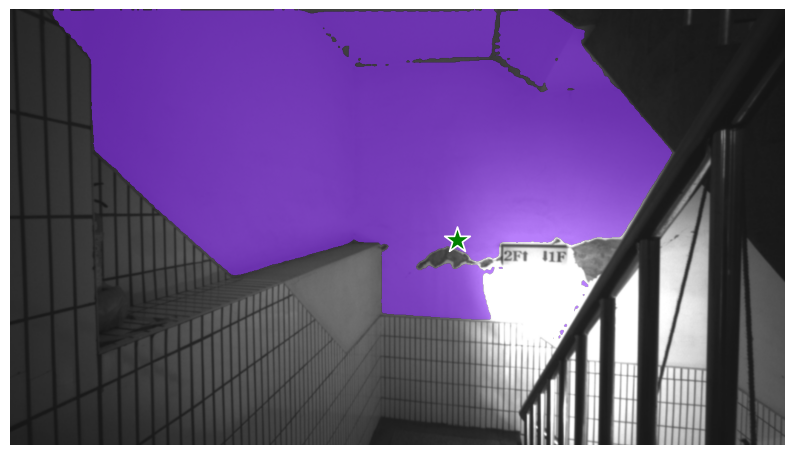

CPU RAM Free: 2.66GB | Used: 12.99GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.26GB | Used: 22.37GB | Util  93% | Total 23.99GB
Took 7.937000274658203 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309904.pgm... 
Bounding Box Coordinate: (600.0074768066406, 670.8497858047485, 813.4150695800781, 716.2720727920532)


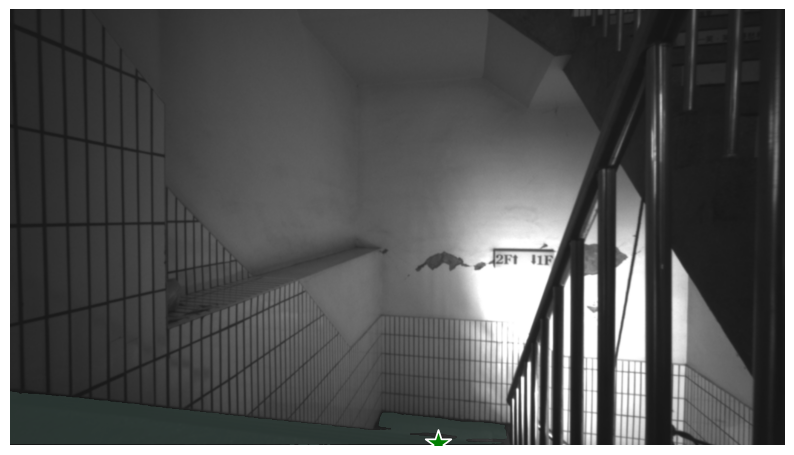

CPU RAM Free: 2.63GB | Used: 13.01GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.26GB | Used: 22.37GB | Util  93% | Total 23.99GB
Took 7.994413137435913 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1723432890.pgm... 
Bounding Box Coordinate: (18.740501403808594, 355.41380882263184, 1280.0, 714.7573757171631)


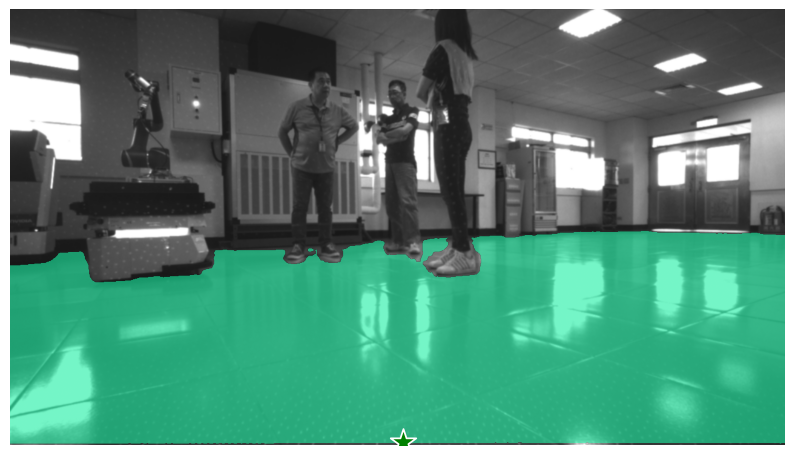

CPU RAM Free: 2.69GB | Used: 12.95GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.26GB | Used: 22.37GB | Util  93% | Total 23.99GB
Took 8.013995170593262 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309912.pgm... 
Bounding Box Coordinate: (2.519683837890625, 409.08923149108887, 1262.9351806640625, 708.8433837890625)


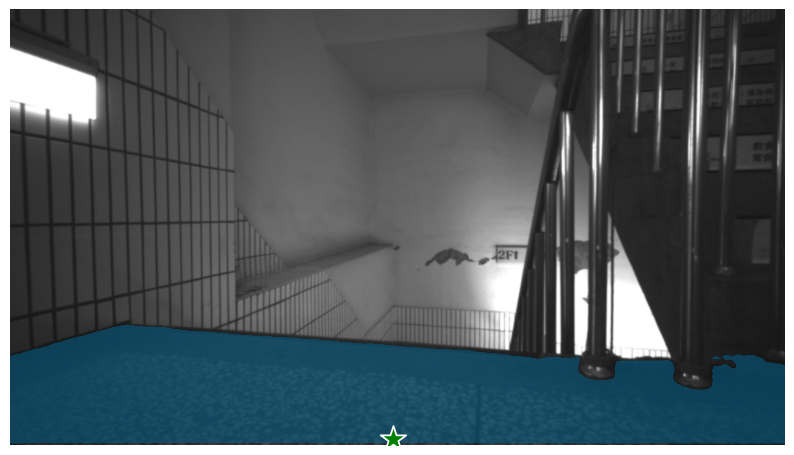

CPU RAM Free: 2.63GB | Used: 13.02GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.26GB | Used: 22.37GB | Util  93% | Total 23.99GB
Took 8.077184438705444 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309897.pgm... 
Bounding Box Coordinate: (391.03443145751953, 91.77438855171204, 1059.5036315917969, 378.87210845947266)


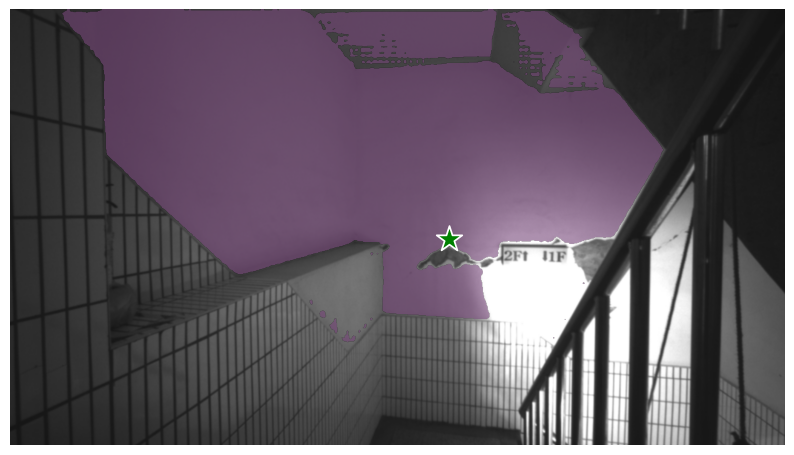

CPU RAM Free: 2.68GB | Used: 12.96GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.26GB | Used: 22.37GB | Util  93% | Total 23.99GB
Took 8.075520515441895 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309899.pgm... 
Bounding Box Coordinate: (403.2797622680664, 89.98103141784668, 1062.0230102539062, 380.01893520355225)


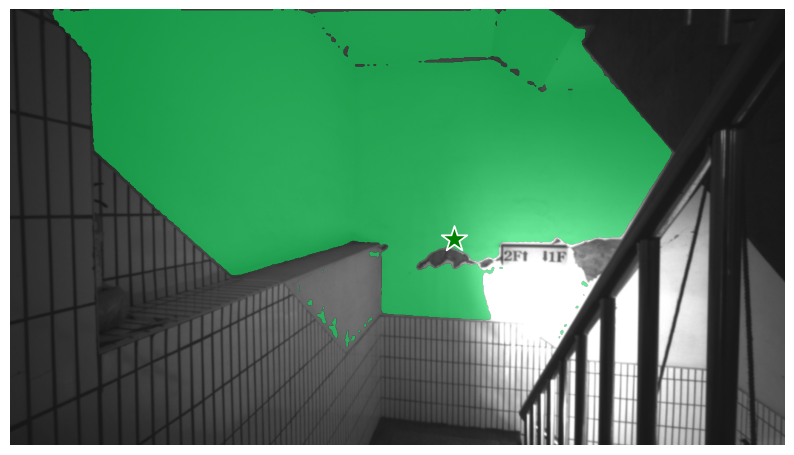

CPU RAM Free: 2.65GB | Used: 12.99GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.26GB | Used: 22.37GB | Util  93% | Total 23.99GB
Took 7.994001865386963 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309916.pgm... 
Bounding Box Coordinate: (20.408096313476562, 419.49328422546387, 1269.183578491211, 711.3077545166016)


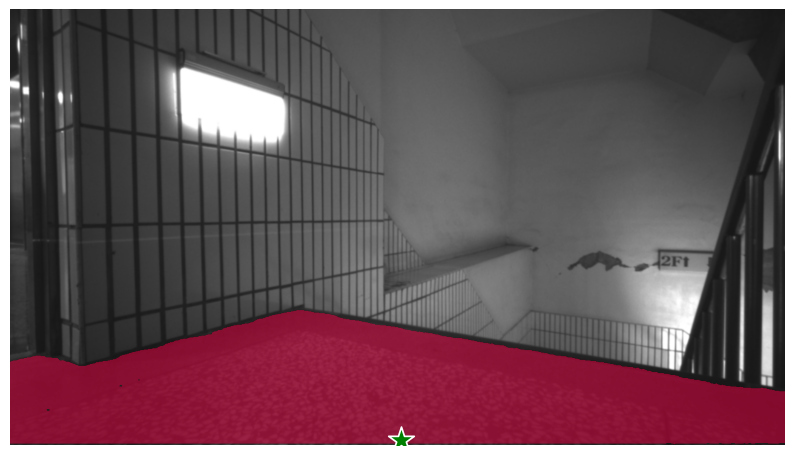

CPU RAM Free: 2.67GB | Used: 12.97GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.26GB | Used: 22.37GB | Util  93% | Total 23.99GB
Took 7.962826728820801 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309917.pgm... 
Bounding Box Coordinate: (21.547088623046875, 420.0626850128174, 1268.0844116210938, 711.3092994689941)


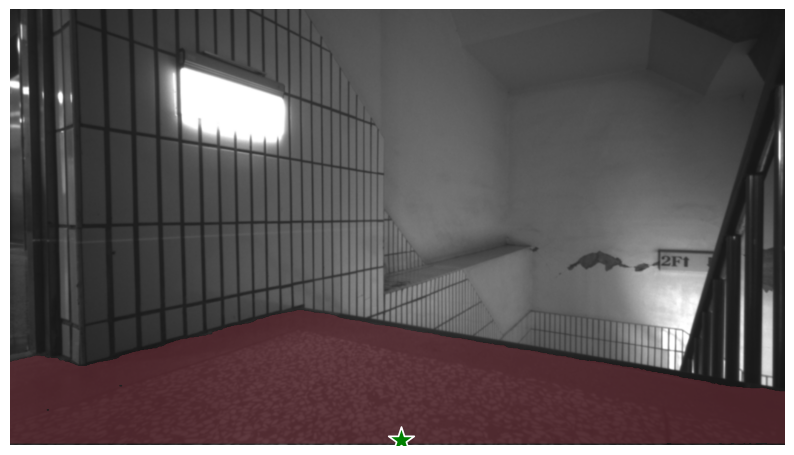

CPU RAM Free: 2.68GB | Used: 12.96GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.26GB | Used: 22.37GB | Util  93% | Total 23.99GB
Took 8.072825193405151 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309844.pgm... 
Bounding Box Coordinate: (0.8962249755859375, 310.918664932251, 1267.2944641113281, 704.3380451202393)


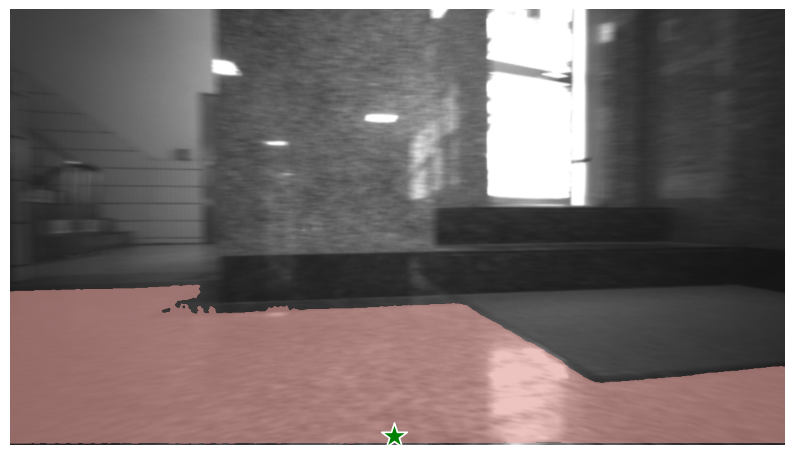

CPU RAM Free: 2.65GB | Used: 12.99GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.26GB | Used: 22.37GB | Util  93% | Total 23.99GB
Took 8.061461925506592 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309935.pgm... 
Bounding Box Coordinate: (34.89299774169922, 199.009051322937, 1216.6957092285156, 703.0495977401733)


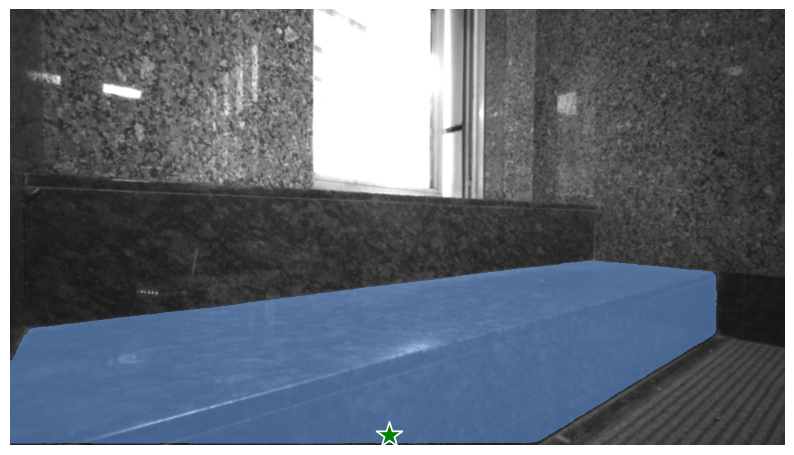

CPU RAM Free: 2.60GB | Used: 13.04GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.26GB | Used: 22.37GB | Util  93% | Total 23.99GB
Took 7.958527088165283 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309936.pgm... 
Bounding Box Coordinate: (33.84956359863281, 213.28413248062134, 1250.9076690673828, 703.295373916626)


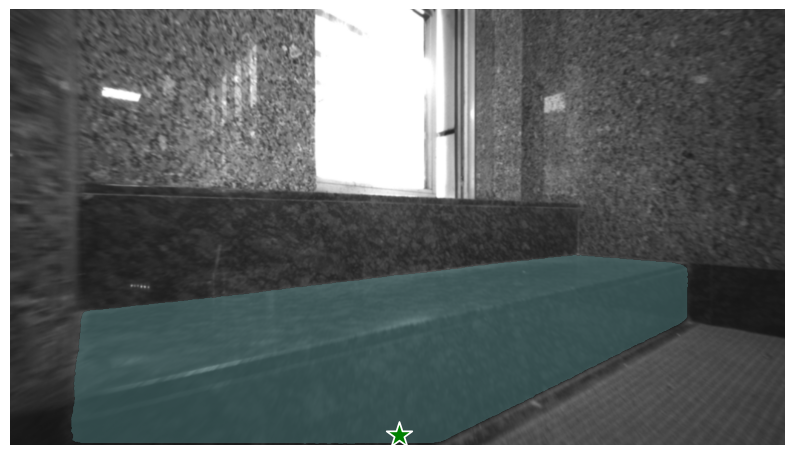

CPU RAM Free: 2.70GB | Used: 12.94GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.26GB | Used: 22.37GB | Util  93% | Total 23.99GB
Took 8.041577339172363 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309872.pgm... 
Bounding Box Coordinate: (70.52230834960938, 191.3354229927063, 1245.2301025390625, 662.0358753204346)


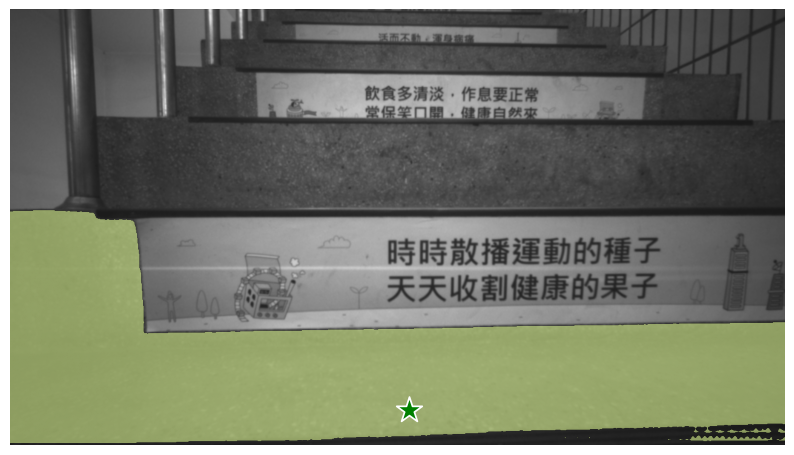

CPU RAM Free: 2.61GB | Used: 13.03GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.26GB | Used: 22.37GB | Util  93% | Total 23.99GB
Took 7.986806869506836 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309928.pgm... 
Bounding Box Coordinate: (19.44446563720703, 77.69938945770264, 1280.0, 715.1947259902954)


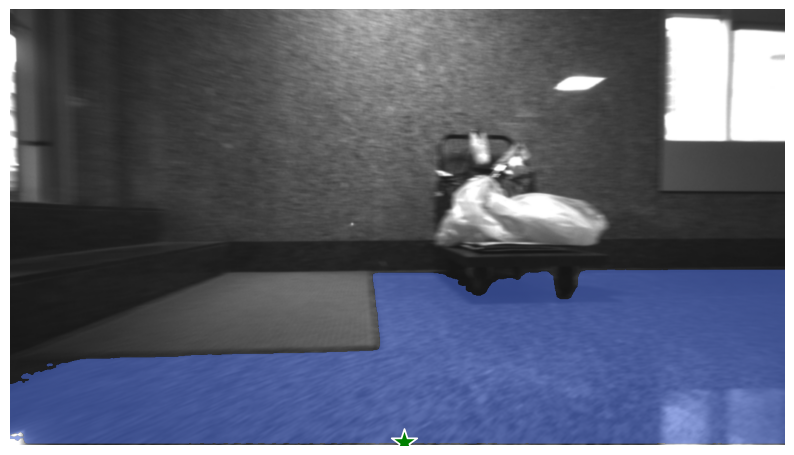

CPU RAM Free: 2.62GB | Used: 13.02GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.26GB | Used: 22.37GB | Util  93% | Total 23.99GB
Took 8.126167297363281 secs to annotate
--------------------------------------------------

Running inference for ./images/test/1722163243@0.25,0.11,-0.73.jpg... 
Bounding Box Coordinate: (16.674199104309082, 195.50792694091797, 706.1656808853149, 1226.4356994628906)


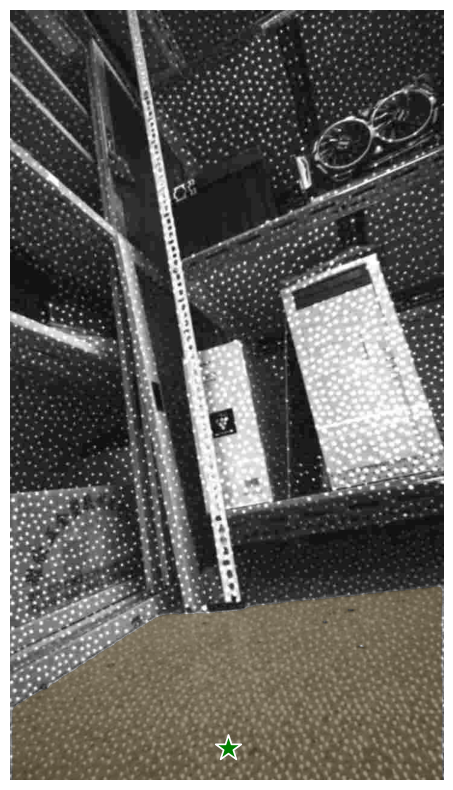

CPU RAM Free: 2.60GB | Used: 13.04GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.26GB | Used: 22.37GB | Util  93% | Total 23.99GB
Took 8.039891719818115 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309841.pgm... 
Bounding Box Coordinate: (0.0, 390.1645088195801, 1274.9778747558594, 711.7721843719482)


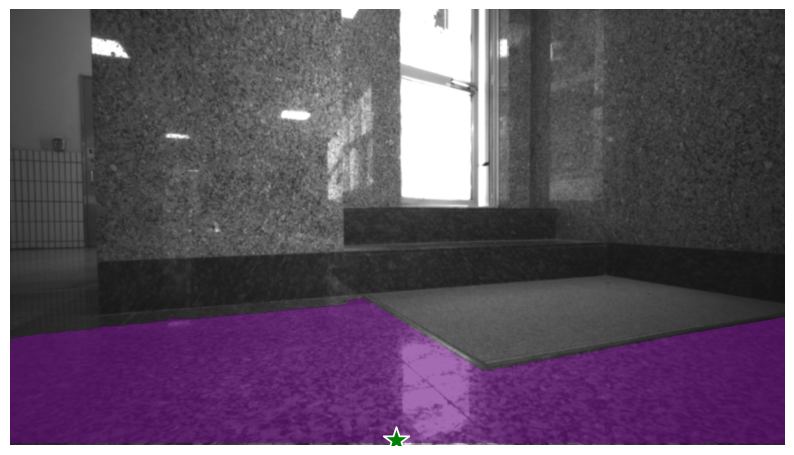

CPU RAM Free: 2.62GB | Used: 13.02GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.26GB | Used: 22.37GB | Util  93% | Total 23.99GB
Took 8.035200357437134 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309910.pgm... 
Bounding Box Coordinate: (0.7181930541992188, 411.92872524261475, 1260.3315734863281, 709.087700843811)


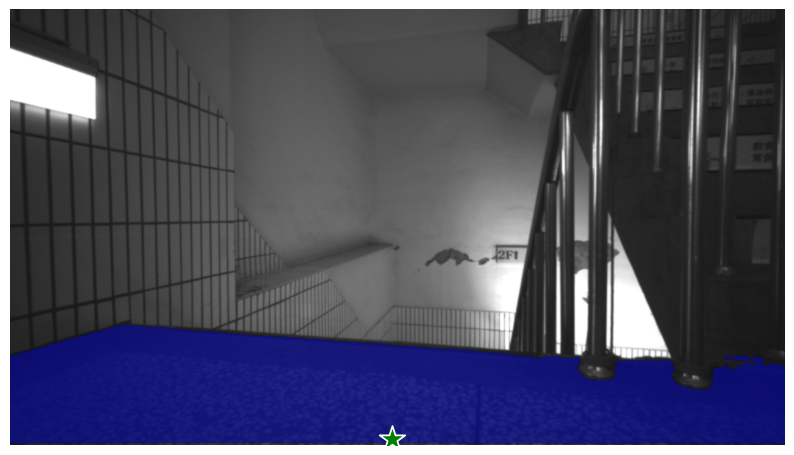

CPU RAM Free: 2.58GB | Used: 13.06GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.26GB | Used: 22.37GB | Util  93% | Total 23.99GB
Took 7.961150884628296 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309870.pgm... 
Bounding Box Coordinate: (48.092918395996094, 199.74026441574097, 1262.95166015625, 682.5849437713623)


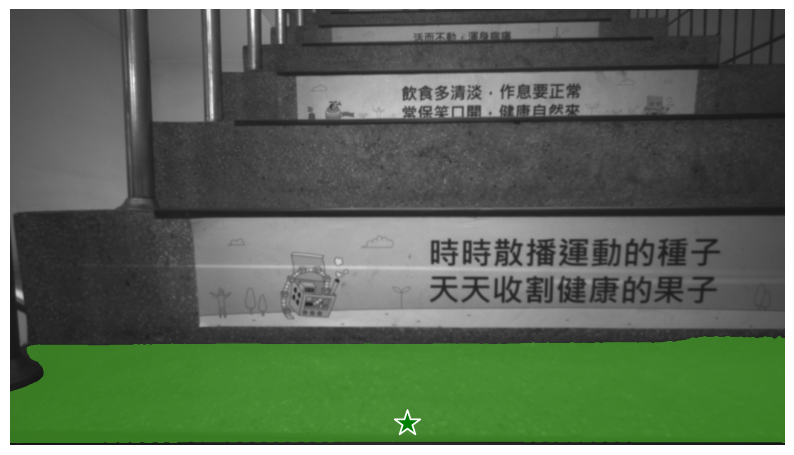

CPU RAM Free: 2.72GB | Used: 12.92GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.28GB | Used: 22.35GB | Util  93% | Total 23.99GB
Took 8.084518432617188 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309896.pgm... 
Bounding Box Coordinate: (139.31764602661133, 488.08977127075195, 671.4976501464844, 694.856071472168)


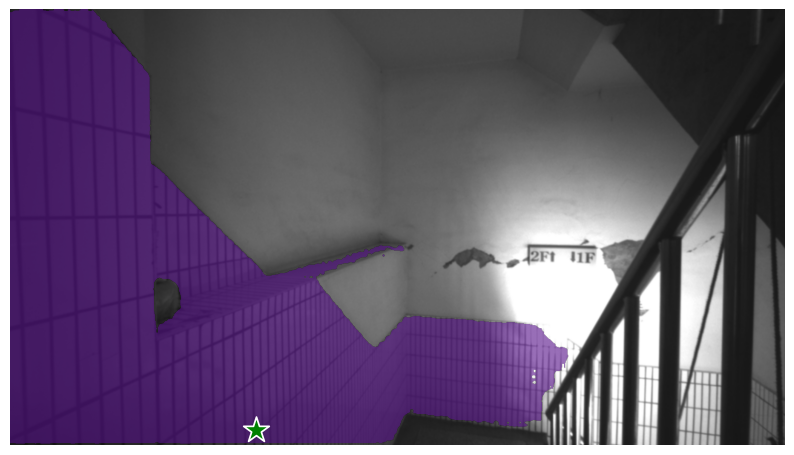

CPU RAM Free: 2.60GB | Used: 13.03GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.27GB | Used: 22.36GB | Util  93% | Total 23.99GB
Took 8.030616760253906 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309880.pgm... 
Bounding Box Coordinate: (0.0, 400.62267780303955, 1270.6494140625, 712.6761102676392)


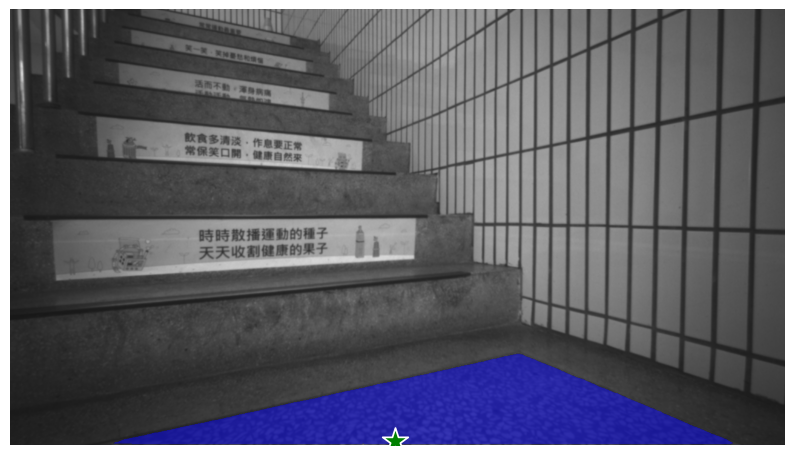

CPU RAM Free: 2.63GB | Used: 13.01GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.27GB | Used: 22.36GB | Util  93% | Total 23.99GB
Took 8.073650598526001 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309902.pgm... 
Bounding Box Coordinate: (396.56036376953125, 90.40036797523499, 1068.9889526367188, 382.2931480407715)


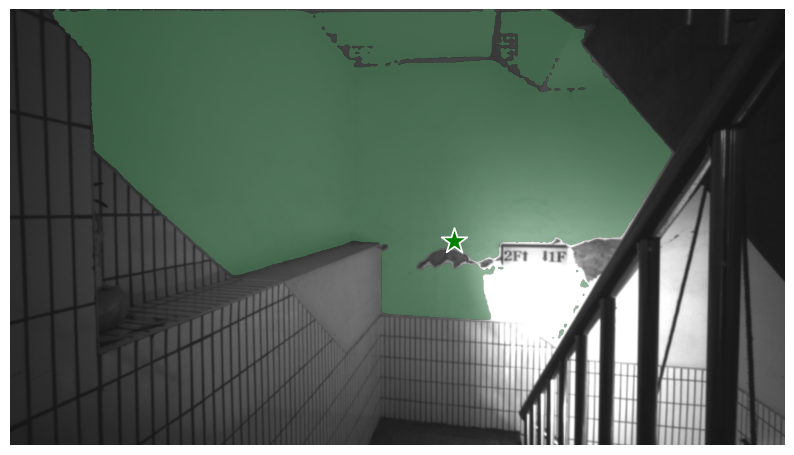

CPU RAM Free: 3.52GB | Used: 13.04GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.27GB | Used: 22.36GB | Util  93% | Total 23.99GB
Took 8.379609823226929 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309842.pgm... 
Bounding Box Coordinate: (0.0, 390.8048915863037, 1276.2240600585938, 712.2742080688477)


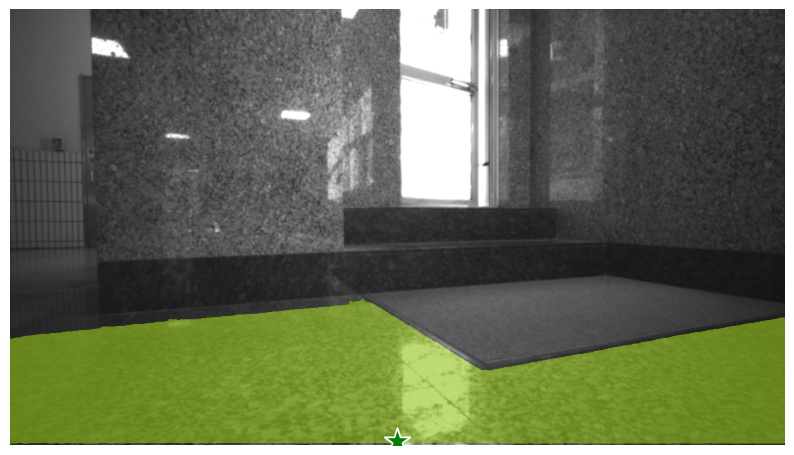

CPU RAM Free: 3.50GB | Used: 13.04GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.27GB | Used: 22.36GB | Util  93% | Total 23.99GB
Took 8.07447862625122 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309885.pgm... 
Bounding Box Coordinate: (19.63703155517578, 336.2439751625061, 1280.0, 715.012378692627)


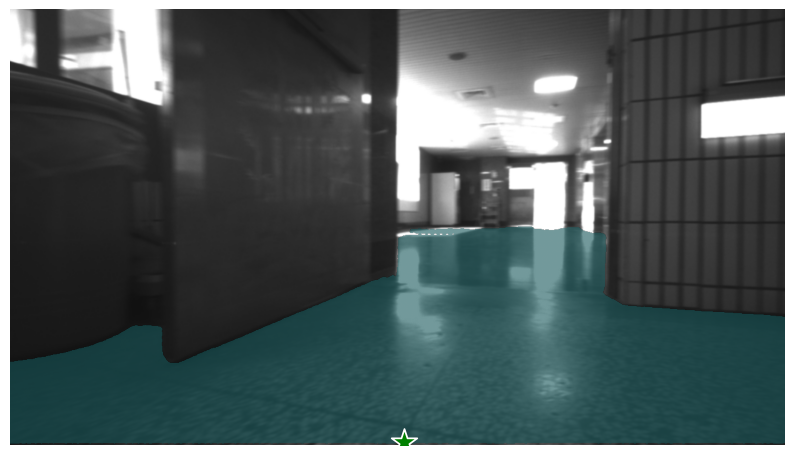

CPU RAM Free: 3.46GB | Used: 13.08GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.27GB | Used: 22.36GB | Util  93% | Total 23.99GB
Took 7.964535713195801 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309852.pgm... 
Bounding Box Coordinate: (31.815643310546875, 403.7760543823242, 1280.0, 707.0987033843994)


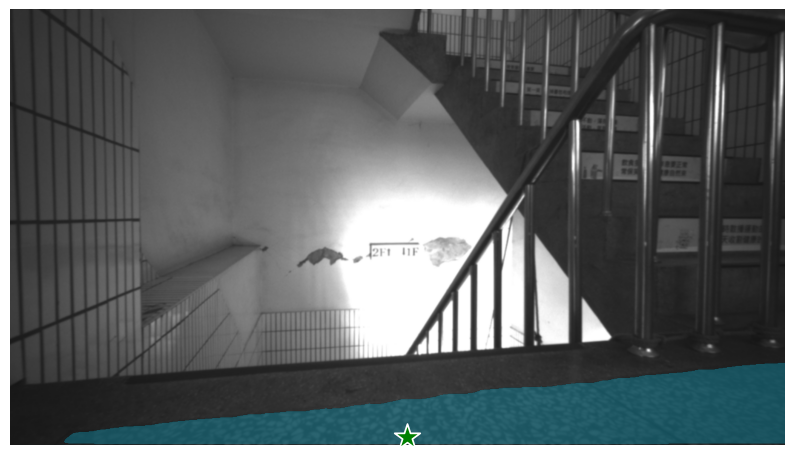

CPU RAM Free: 3.47GB | Used: 13.07GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.27GB | Used: 22.36GB | Util  93% | Total 23.99GB
Took 7.969278335571289 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1723000217.pgm... 
Bounding Box Coordinate: (803.22265625, 458.27643871307373, 1266.1668395996094, 708.4081792831421)


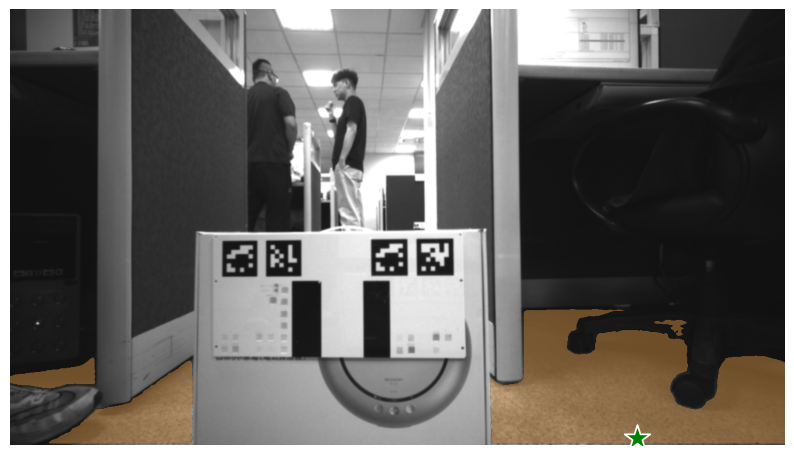

CPU RAM Free: 3.48GB | Used: 13.06GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.27GB | Used: 22.36GB | Util  93% | Total 23.99GB
Took 8.079784870147705 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309879.pgm... 
Bounding Box Coordinate: (5.167083740234375, 399.0829610824585, 1265.9452819824219, 712.9326581954956)


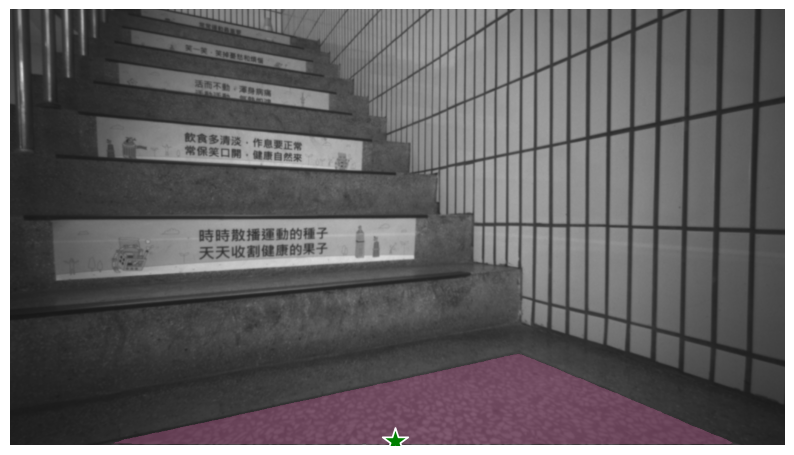

CPU RAM Free: 3.52GB | Used: 13.02GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.27GB | Used: 22.36GB | Util  93% | Total 23.99GB
Took 8.113134384155273 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309866.pgm... 
Bounding Box Coordinate: (5.397377014160156, 418.67849349975586, 1197.0338439941406, 710.0962543487549)


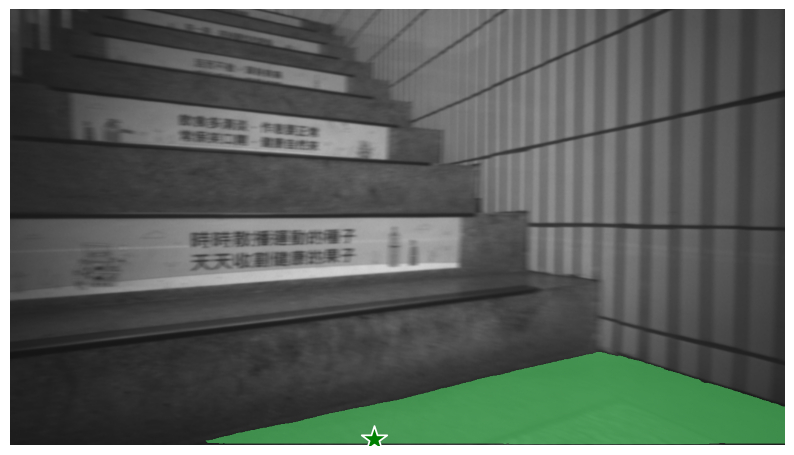

CPU RAM Free: 3.44GB | Used: 13.10GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.27GB | Used: 22.36GB | Util  93% | Total 23.99GB
Took 8.053740501403809 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309840.pgm... 
Bounding Box Coordinate: (0.0, 391.9991397857666, 1277.7799987792969, 711.9383525848389)


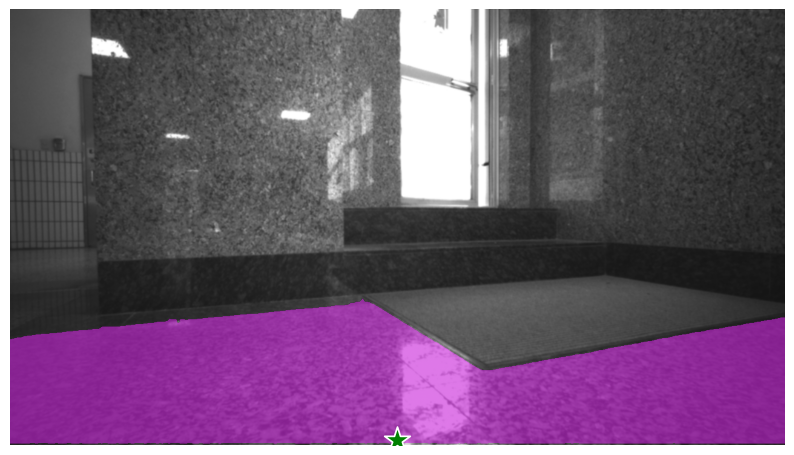

CPU RAM Free: 3.45GB | Used: 13.09GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.27GB | Used: 22.36GB | Util  93% | Total 23.99GB
Took 7.975699186325073 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309862.pgm... 
Bounding Box Coordinate: (13.316917419433594, 437.9941749572754, 1274.0562438964844, 712.1012592315674)


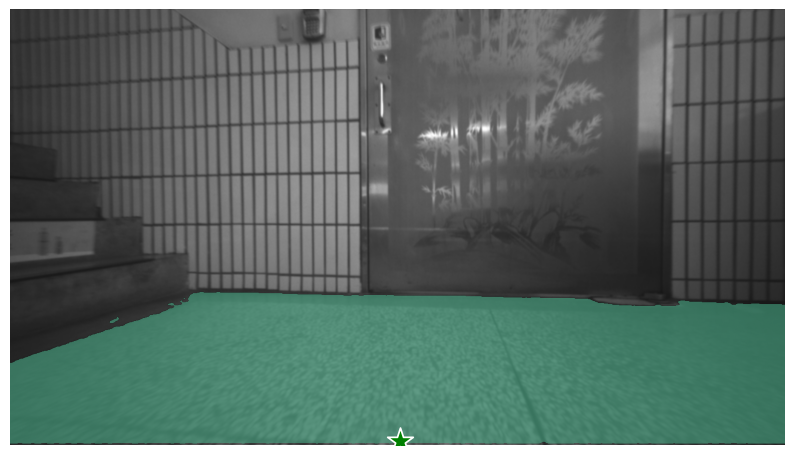

CPU RAM Free: 3.50GB | Used: 13.04GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.27GB | Used: 22.36GB | Util  93% | Total 23.99GB
Took 7.965960502624512 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309857.pgm... 
Bounding Box Coordinate: (60.19153594970703, 542.110447883606, 1264.443359375, 716.7874002456665)


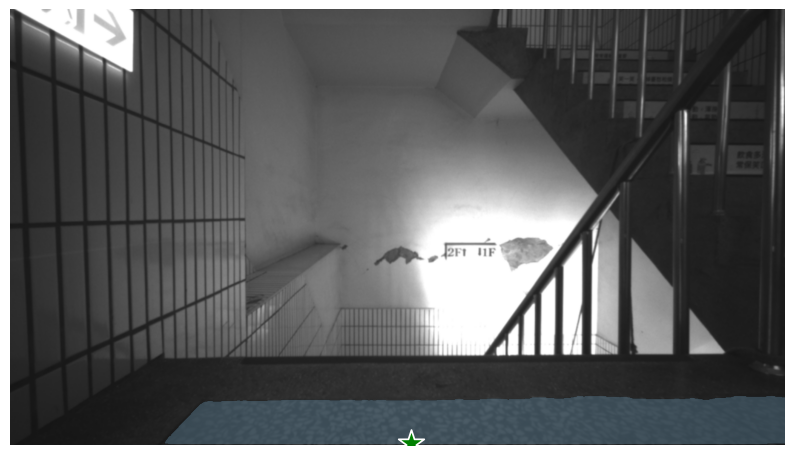

CPU RAM Free: 3.43GB | Used: 13.11GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.27GB | Used: 22.36GB | Util  93% | Total 23.99GB
Took 8.091984748840332 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309923.pgm... 
Bounding Box Coordinate: (167.2772216796875, 327.9307150840759, 1280.0, 713.139123916626)


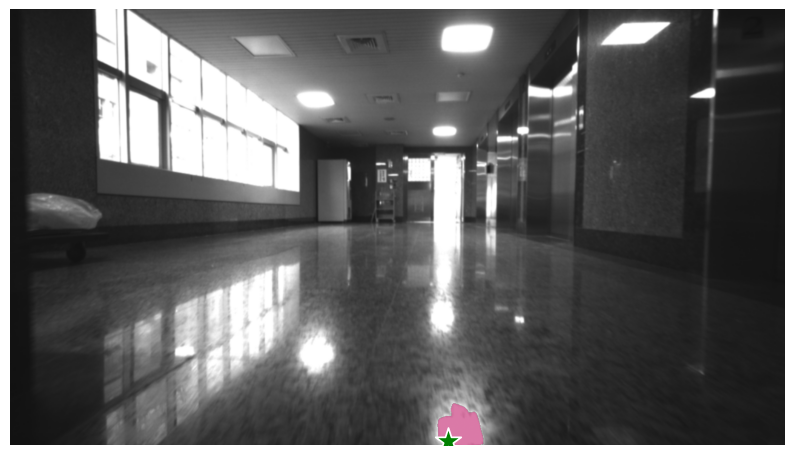

CPU RAM Free: 3.48GB | Used: 13.06GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.27GB | Used: 22.36GB | Util  93% | Total 23.99GB
Took 8.123830795288086 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309850.pgm... 
Bounding Box Coordinate: (7.653312683105469, 398.9744710922241, 1273.7748718261719, 717.7308511734009)


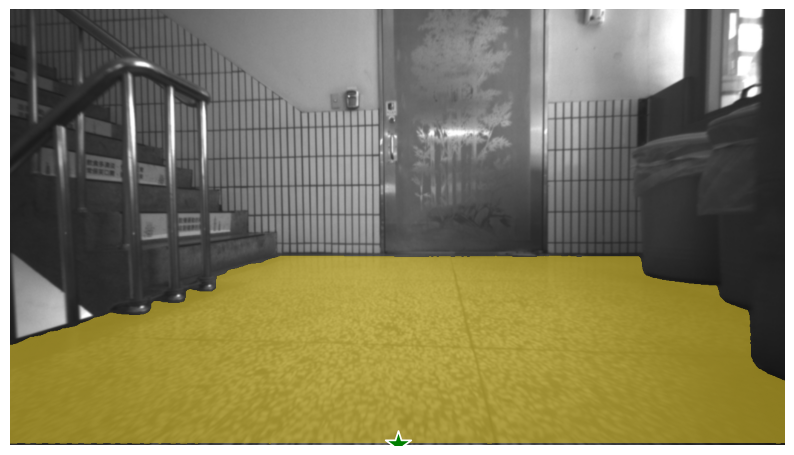

CPU RAM Free: 3.53GB | Used: 13.02GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.27GB | Used: 22.36GB | Util  93% | Total 23.99GB
Took 8.004400491714478 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309939.pgm... 
Bounding Box Coordinate: (30.526466369628906, 403.08696269989014, 1253.8151550292969, 711.1400842666626)


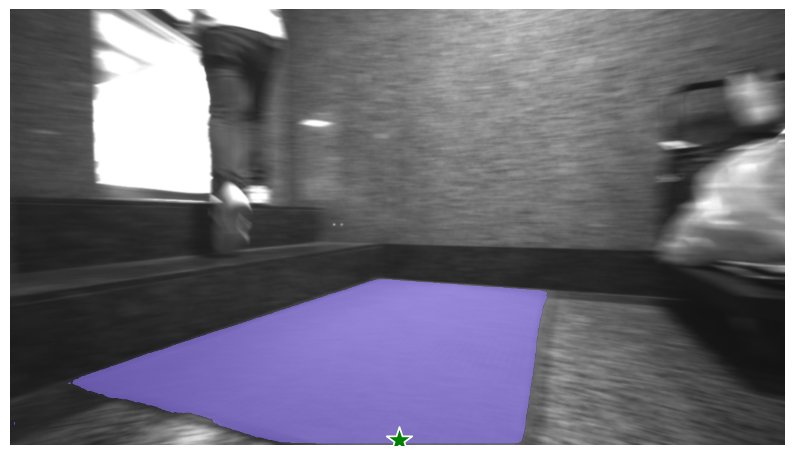

CPU RAM Free: 3.42GB | Used: 13.13GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.27GB | Used: 22.36GB | Util  93% | Total 23.99GB
Took 8.198436260223389 secs to annotate
--------------------------------------------------

Running inference for ./images/test/1722163203@0.30,0.07,2.76.jpg... 
Bounding Box Coordinate: (6.150155067443848, 694.6865844726562, 709.9688816070557, 1255.9701538085938)


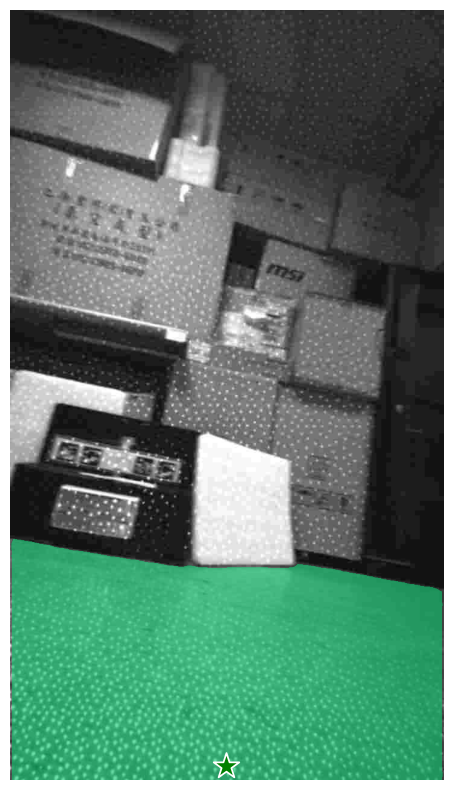

CPU RAM Free: 3.47GB | Used: 13.08GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.28GB | Used: 22.34GB | Util  93% | Total 23.99GB
Took 8.10623025894165 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309922.pgm... 
Bounding Box Coordinate: (98.4621810913086, 351.32206678390503, 1263.2322692871094, 715.0210475921631)


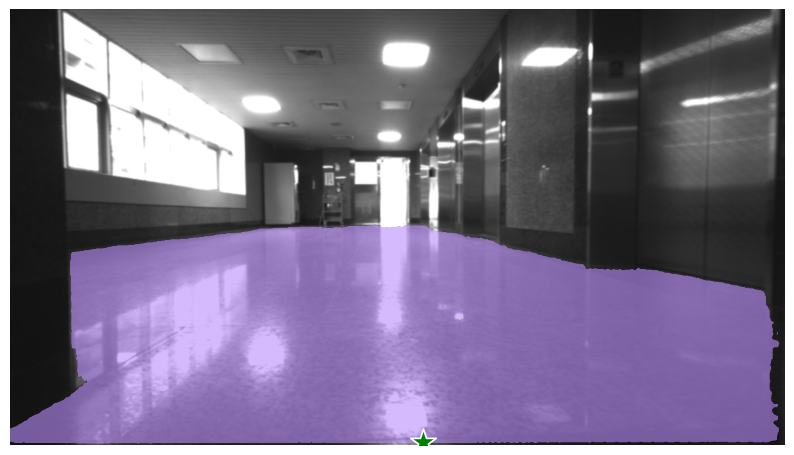

CPU RAM Free: 3.49GB | Used: 13.06GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.28GB | Used: 22.34GB | Util  93% | Total 23.99GB
Took 8.024591445922852 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309864.pgm... 
Bounding Box Coordinate: (8.245697021484375, 407.0965003967285, 1271.2377166748047, 713.2336235046387)


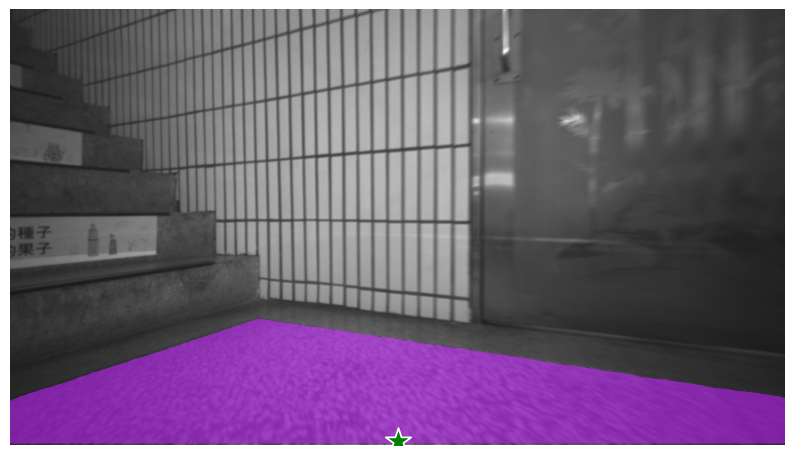

CPU RAM Free: 3.38GB | Used: 13.17GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.28GB | Used: 22.34GB | Util  93% | Total 23.99GB
Took 8.07631230354309 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309853.pgm... 
Bounding Box Coordinate: (66.57299041748047, 542.4984455108643, 1266.73828125, 716.5781021118164)


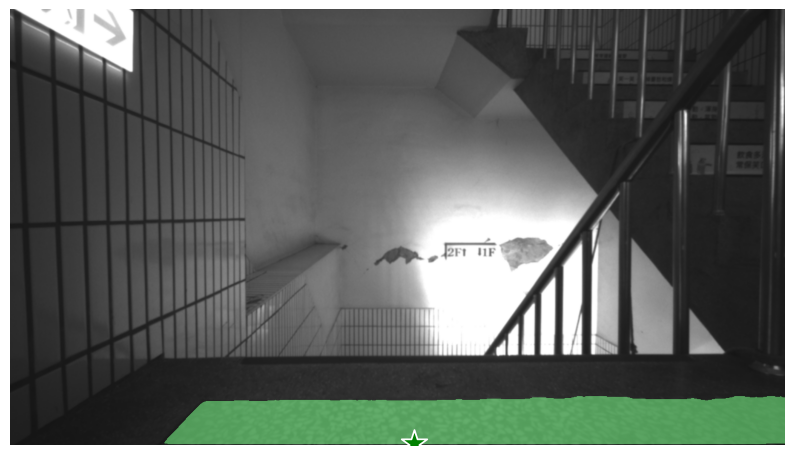

CPU RAM Free: 3.43GB | Used: 13.12GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.28GB | Used: 22.34GB | Util  93% | Total 23.99GB
Took 8.091404676437378 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309863.pgm... 
Bounding Box Coordinate: (3.235931396484375, 390.89810371398926, 1275.1239013671875, 709.7684669494629)


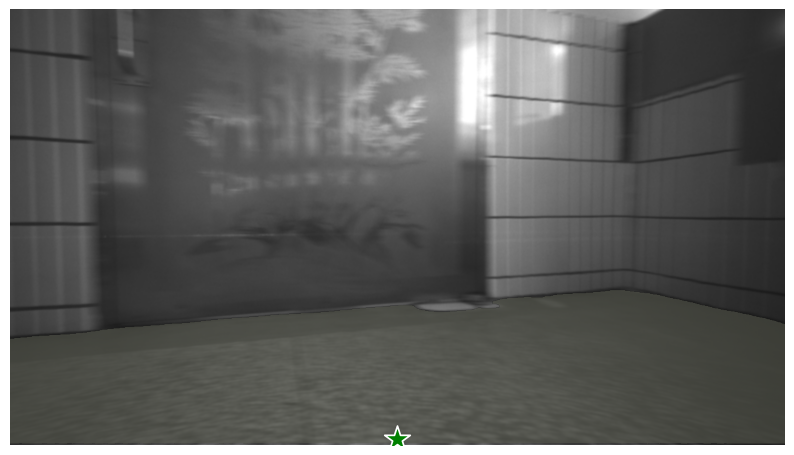

CPU RAM Free: 3.46GB | Used: 13.09GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.28GB | Used: 22.34GB | Util  93% | Total 23.99GB
Took 7.990870237350464 secs to annotate
--------------------------------------------------

Running inference for ./images/test/1722163269@-0.34,0.54,2.36.jpg... 
Bounding Box Coordinate: (21.692161560058594, 657.0103454589844, 702.4641036987305, 1248.1634521484375)


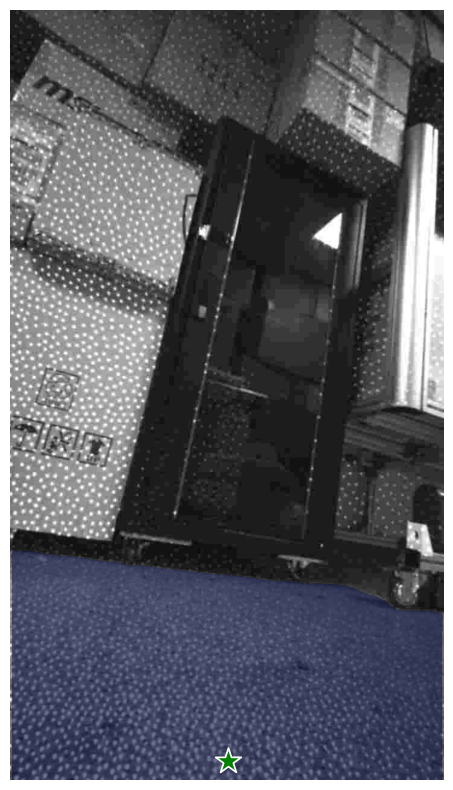

CPU RAM Free: 3.36GB | Used: 13.18GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.28GB | Used: 22.34GB | Util  93% | Total 23.99GB
Took 8.039982557296753 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309845.pgm... 
Bounding Box Coordinate: (10.950889587402344, 288.62669706344604, 1264.3873596191406, 710.0156593322754)


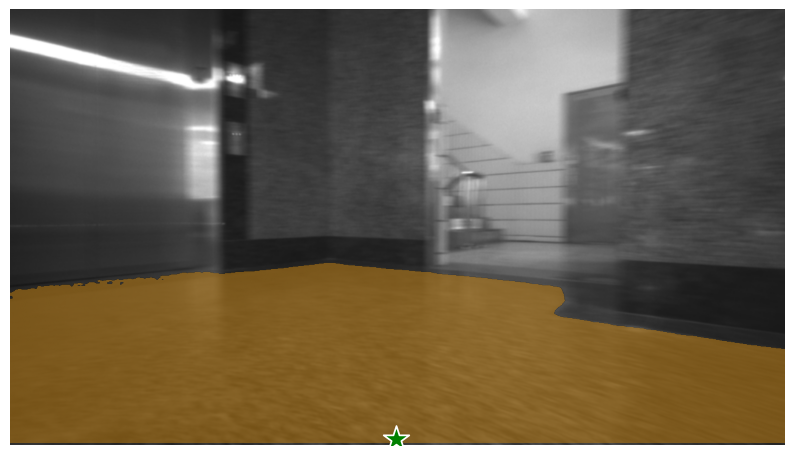

CPU RAM Free: 3.40GB | Used: 13.15GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.28GB | Used: 22.34GB | Util  93% | Total 23.99GB
Took 7.915760040283203 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309881.pgm... 
Bounding Box Coordinate: (0.0, 402.0340347290039, 1269.2037963867188, 713.0135536193848)


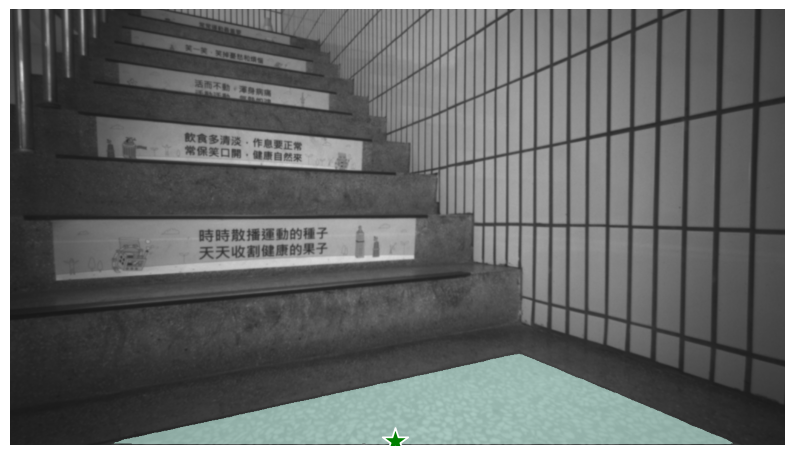

CPU RAM Free: 3.43GB | Used: 13.11GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.28GB | Used: 22.34GB | Util  93% | Total 23.99GB
Took 8.099077224731445 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724308604.pgm... 
Bounding Box Coordinate: (301.57604217529297, 405.5888843536377, 1275.4214477539062, 707.320146560669)


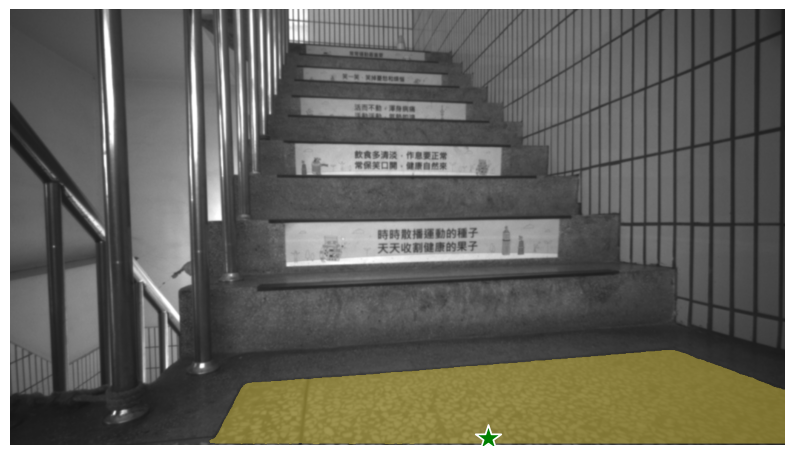

CPU RAM Free: 3.48GB | Used: 13.07GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.28GB | Used: 22.34GB | Util  93% | Total 23.99GB
Took 8.084936380386353 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309933.pgm... 
Bounding Box Coordinate: (26.072654724121094, 214.79925870895386, 1220.0254821777344, 705.3104209899902)


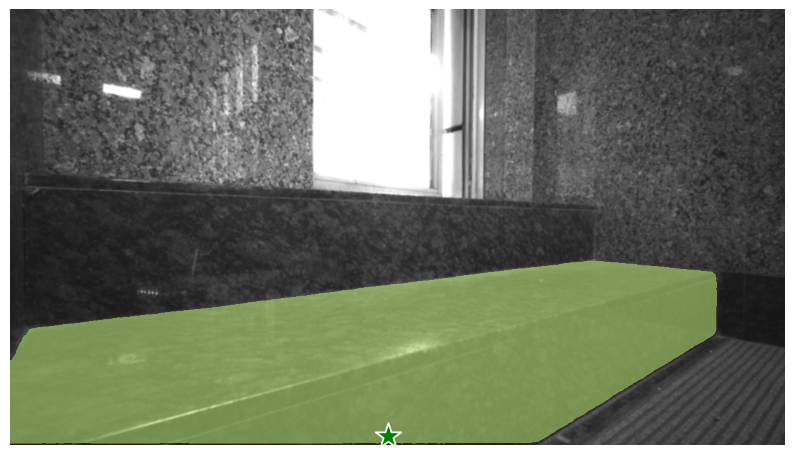

CPU RAM Free: 3.45GB | Used: 13.09GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.28GB | Used: 22.34GB | Util  93% | Total 23.99GB
Took 8.07739806175232 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309856.pgm... 
Bounding Box Coordinate: (57.37220764160156, 542.8179502487183, 1265.746078491211, 716.6179704666138)


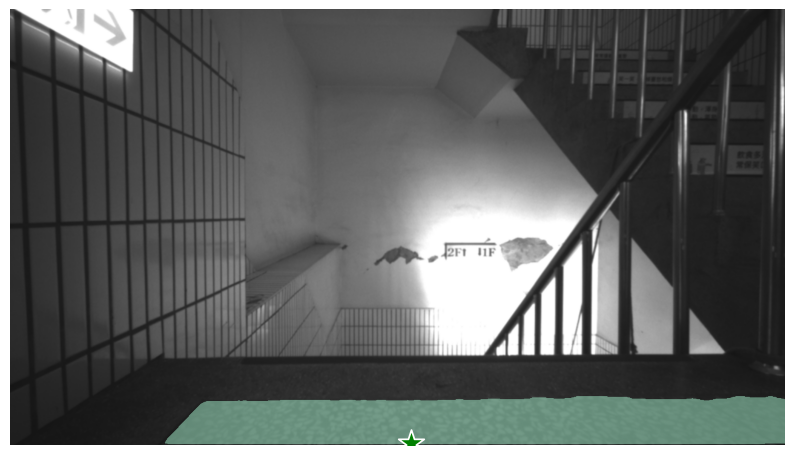

CPU RAM Free: 3.34GB | Used: 13.20GB | Util  23% | Total 62.63GB
GPU RAM Free: 1.28GB | Used: 22.34GB | Util  93% | Total 23.99GB
Took 8.066872596740723 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309871.pgm... 
Bounding Box Coordinate: (70.01972198486328, 191.29928827285767, 1248.3094787597656, 663.0507373809814)


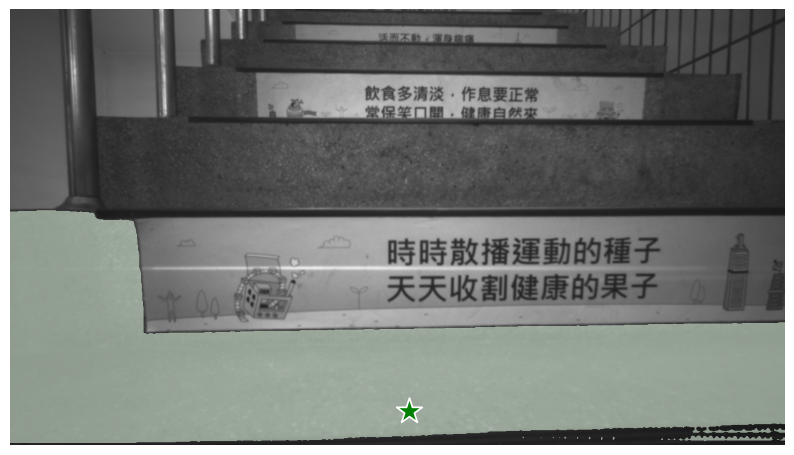

CPU RAM Free: 3.48GB | Used: 13.07GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.28GB | Used: 22.34GB | Util  93% | Total 23.99GB
Took 8.056064128875732 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309865.pgm... 
Bounding Box Coordinate: (13.742942810058594, 376.64467334747314, 1256.6133117675781, 714.0803003311157)


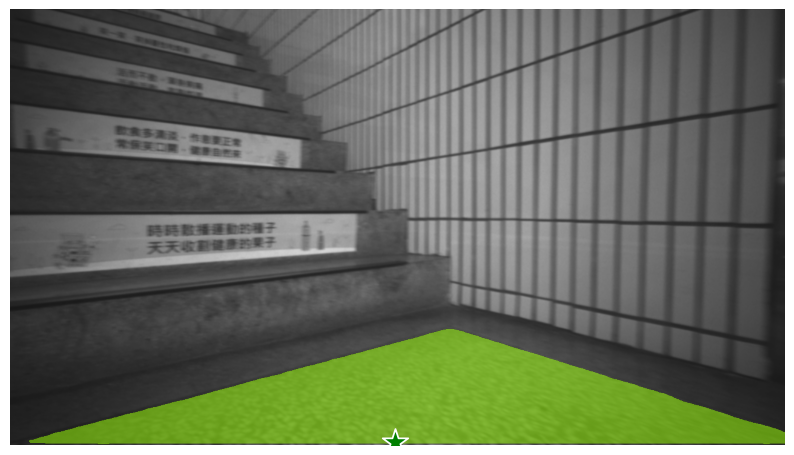

CPU RAM Free: 3.43GB | Used: 13.12GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.28GB | Used: 22.34GB | Util  93% | Total 23.99GB
Took 8.092344284057617 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309855.pgm... 
Bounding Box Coordinate: (63.56292724609375, 542.7506160736084, 1268.9372253417969, 716.6405868530273)


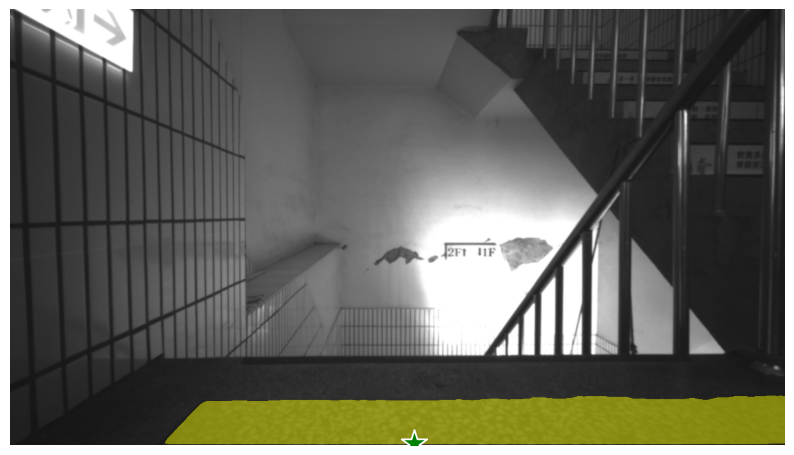

CPU RAM Free: 3.54GB | Used: 13.01GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.28GB | Used: 22.34GB | Util  93% | Total 23.99GB
Took 8.255318403244019 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309888.pgm... 
Bounding Box Coordinate: (14.307785034179688, 352.4805021286011, 1230.6627655029297, 714.145188331604)


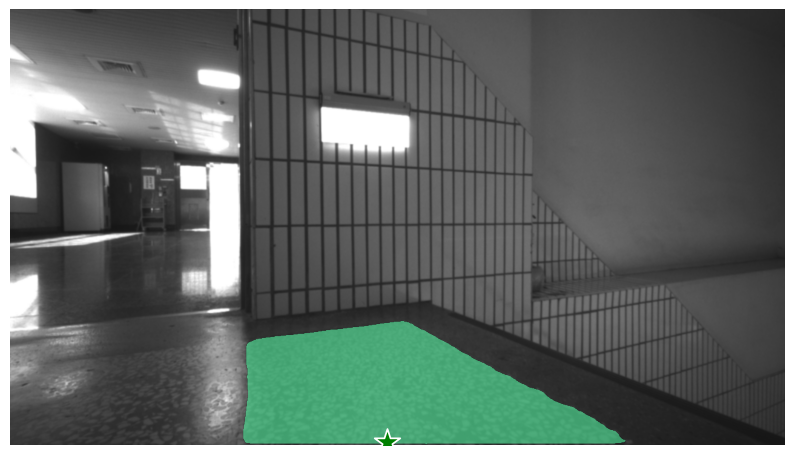

CPU RAM Free: 3.40GB | Used: 13.14GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.28GB | Used: 22.34GB | Util  93% | Total 23.99GB
Took 8.075337409973145 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309903.pgm... 
Bounding Box Coordinate: (913.0157470703125, 412.5612545013428, 1280.0, 684.7043609619141)


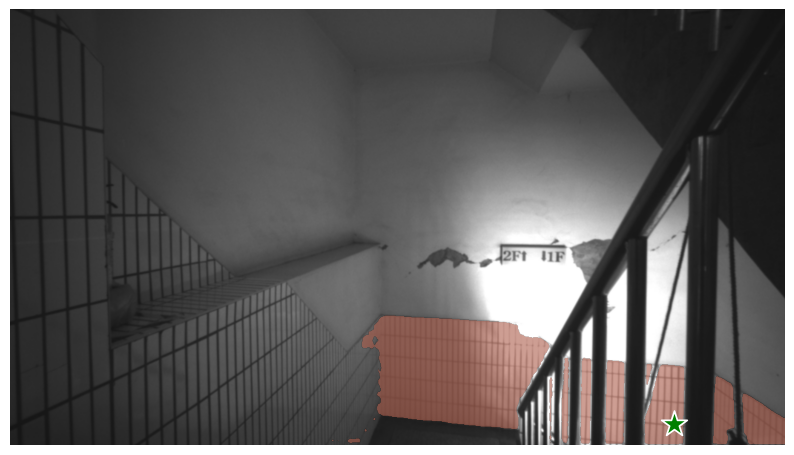

CPU RAM Free: 3.37GB | Used: 13.18GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.28GB | Used: 22.34GB | Util  93% | Total 23.99GB
Took 8.122885465621948 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309883.pgm... 
Bounding Box Coordinate: (8.293495178222656, 402.5474739074707, 1238.1610107421875, 712.3875904083252)


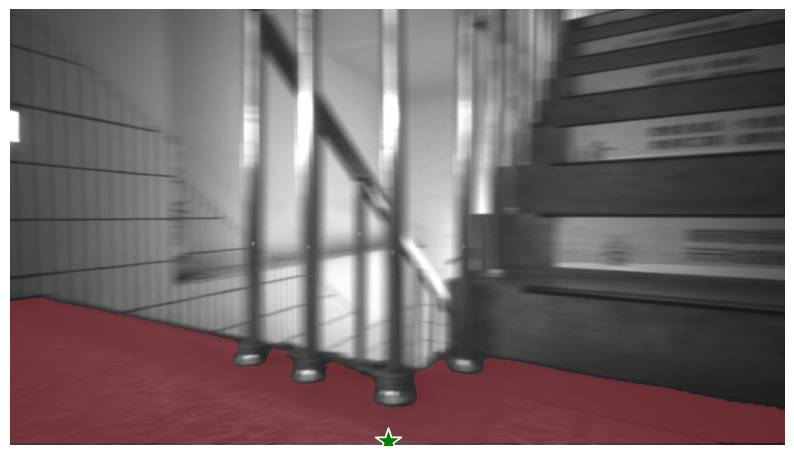

CPU RAM Free: 3.30GB | Used: 13.25GB | Util  23% | Total 62.63GB
GPU RAM Free: 1.28GB | Used: 22.34GB | Util  93% | Total 23.99GB
Took 8.044063568115234 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309908.pgm... 
Bounding Box Coordinate: (2.9315948486328125, 402.4336624145508, 1260.276870727539, 708.1858348846436)


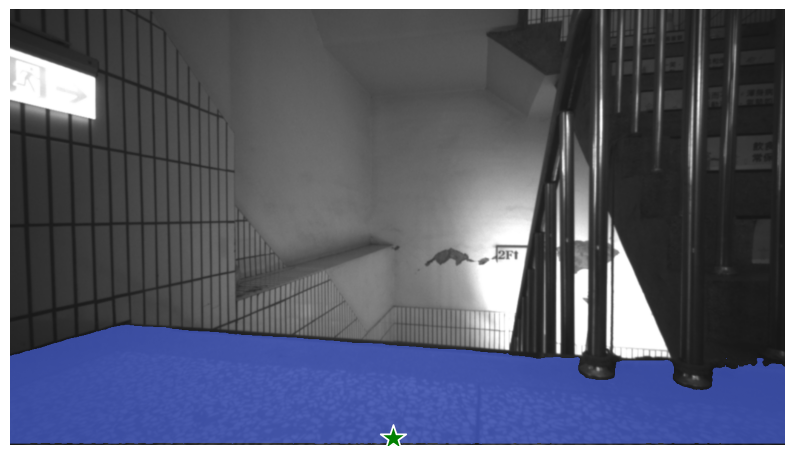

CPU RAM Free: 3.29GB | Used: 13.25GB | Util  23% | Total 62.63GB
GPU RAM Free: 1.28GB | Used: 22.34GB | Util  93% | Total 23.99GB
Took 7.960679531097412 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309929.pgm... 
Bounding Box Coordinate: (3.0502700805664062, 34.326331615448, 1270.6410217285156, 696.5034198760986)


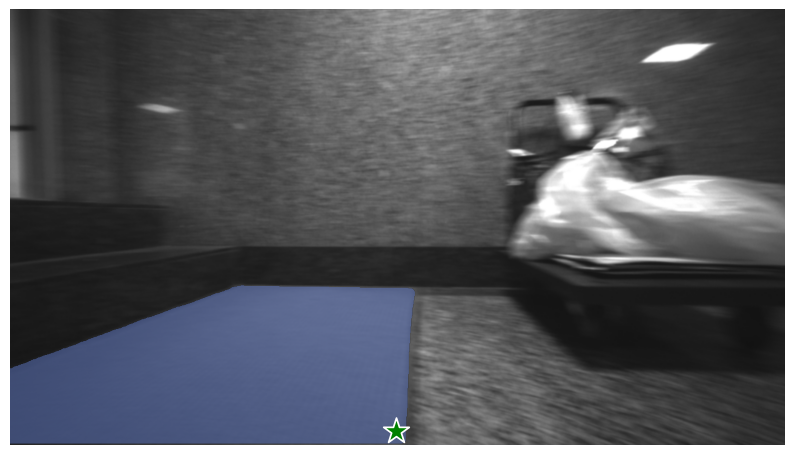

CPU RAM Free: 3.36GB | Used: 13.18GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.28GB | Used: 22.34GB | Util  93% | Total 23.99GB
Took 7.963961124420166 secs to annotate
--------------------------------------------------

Running inference for ./images/test/1722163218@-0.44,0.67,2.10.jpg... 
Bounding Box Coordinate: (13.357765674591064, 695.5788421630859, 701.1752700805664, 1251.202163696289)


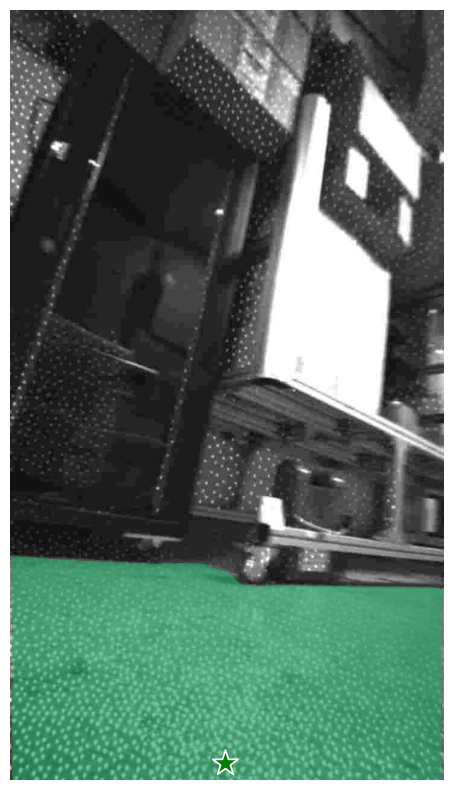

CPU RAM Free: 3.30GB | Used: 13.24GB | Util  23% | Total 62.63GB
GPU RAM Free: 1.28GB | Used: 22.34GB | Util  93% | Total 23.99GB
Took 8.106556177139282 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309889.pgm... 
Bounding Box Coordinate: (13.023452758789062, 349.79970932006836, 1232.3395538330078, 716.0891246795654)


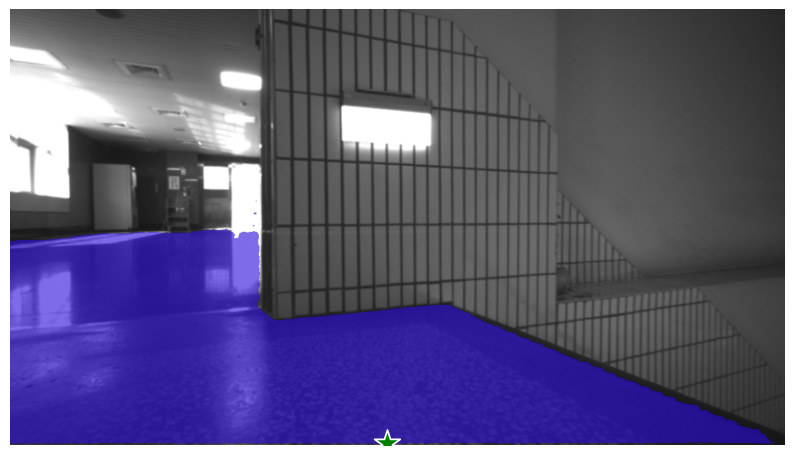

CPU RAM Free: 3.33GB | Used: 13.21GB | Util  23% | Total 62.63GB
GPU RAM Free: 1.28GB | Used: 22.34GB | Util  93% | Total 23.99GB
Took 8.065374374389648 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309937.pgm... 
Bounding Box Coordinate: (27.33837127685547, 166.84730529785156, 1277.0423889160156, 702.899694442749)


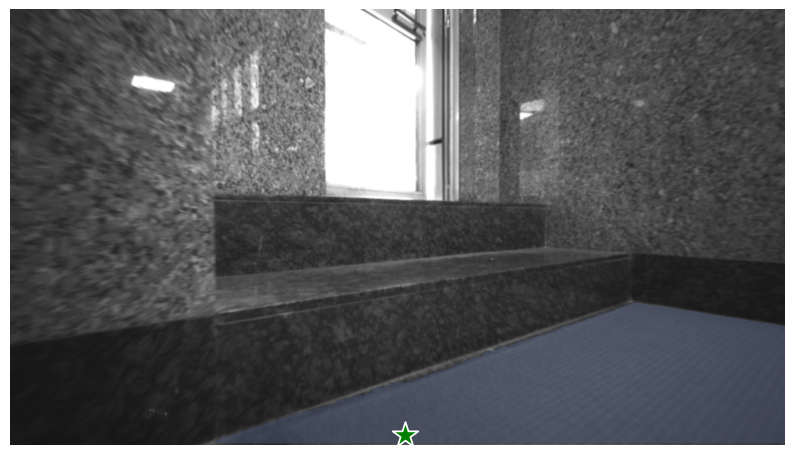

CPU RAM Free: 3.28GB | Used: 13.25GB | Util  23% | Total 62.63GB
GPU RAM Free: 1.18GB | Used: 22.44GB | Util  94% | Total 23.99GB
Took 8.306127786636353 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309847.pgm... 
Bounding Box Coordinate: (8.386344909667969, 82.87208318710327, 1280.0, 698.9083957672119)


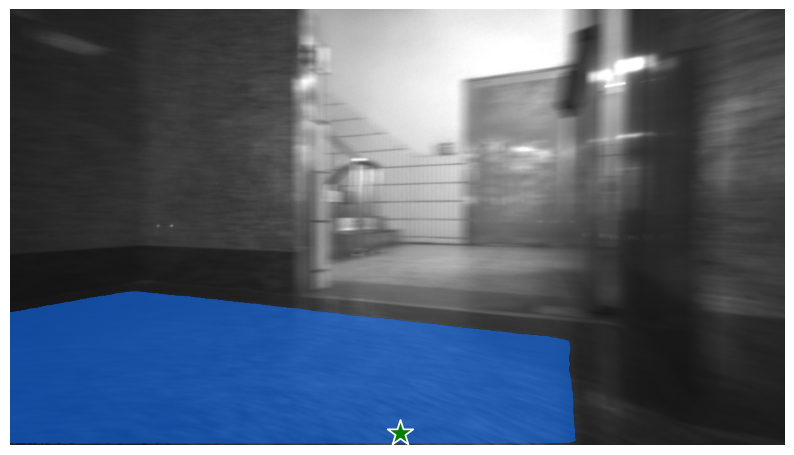

CPU RAM Free: 3.21GB | Used: 13.32GB | Util  23% | Total 62.63GB
GPU RAM Free: 1.26GB | Used: 22.36GB | Util  93% | Total 23.99GB
Took 8.12126612663269 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309932.pgm... 
Bounding Box Coordinate: (22.721519470214844, 222.98418045043945, 1219.4468688964844, 707.3258113861084)


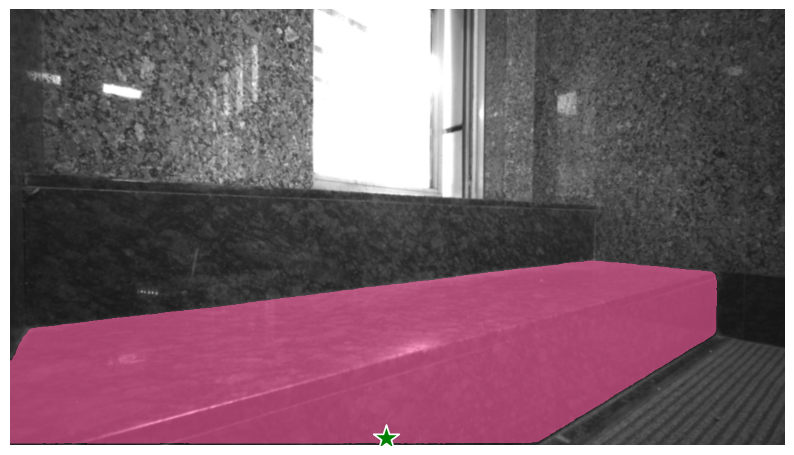

CPU RAM Free: 3.22GB | Used: 13.32GB | Util  23% | Total 62.63GB
GPU RAM Free: 1.26GB | Used: 22.36GB | Util  93% | Total 23.99GB
Took 8.228116512298584 secs to annotate
--------------------------------------------------

Running inference for ./images/test/1722163208@-0.02,0.31,2.57.jpg... 
Bounding Box Coordinate: (8.633687496185303, 600.3135299682617, 709.8095798492432, 1244.1259765625)


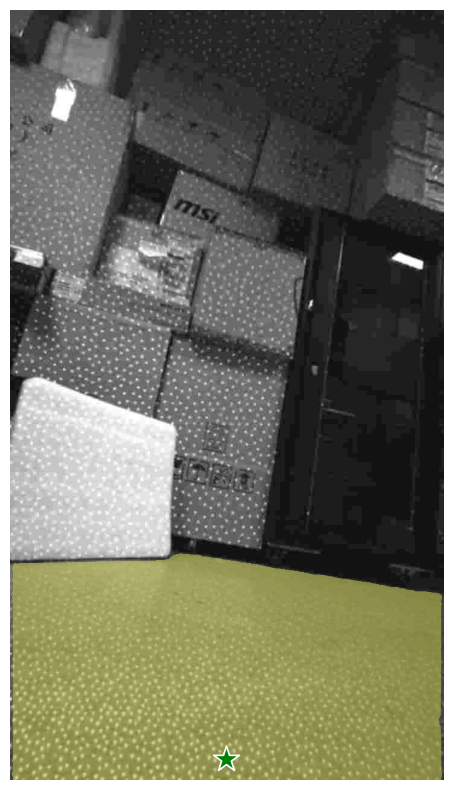

CPU RAM Free: 3.18GB | Used: 13.35GB | Util  23% | Total 62.63GB
GPU RAM Free: 1.26GB | Used: 22.36GB | Util  93% | Total 23.99GB
Took 8.156736135482788 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309938.pgm... 
Bounding Box Coordinate: (506.77745819091797, 430.5898189544678, 1266.9464111328125, 710.7777500152588)


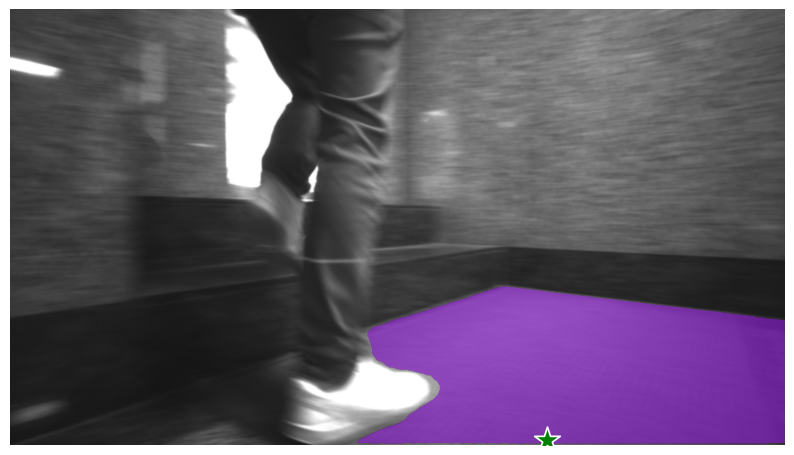

CPU RAM Free: 3.31GB | Used: 13.19GB | Util  23% | Total 62.63GB
GPU RAM Free: 1.26GB | Used: 22.36GB | Util  93% | Total 23.99GB
Took 8.11223554611206 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309877.pgm... 
Bounding Box Coordinate: (29.926719665527344, 418.52580070495605, 1259.9972534179688, 711.2957382202148)


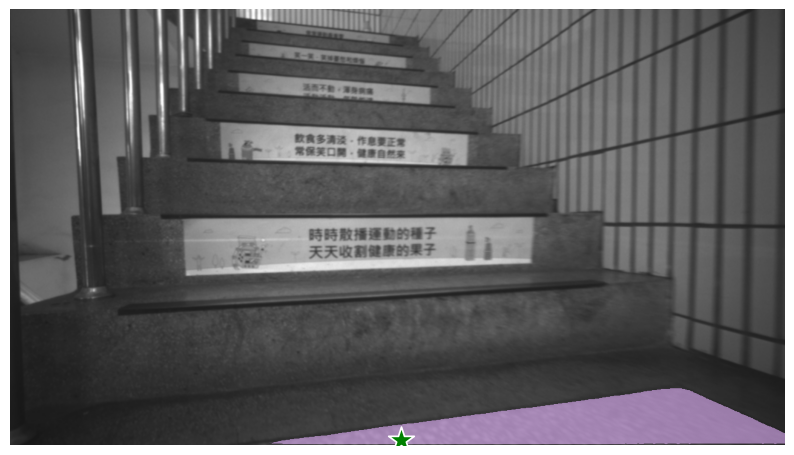

CPU RAM Free: 3.18GB | Used: 13.32GB | Util  23% | Total 62.63GB
GPU RAM Free: 1.26GB | Used: 22.36GB | Util  93% | Total 23.99GB
Took 8.127800703048706 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309920.pgm... 
Bounding Box Coordinate: (126.83849334716797, 345.906879901886, 1248.934326171875, 712.6769256591797)


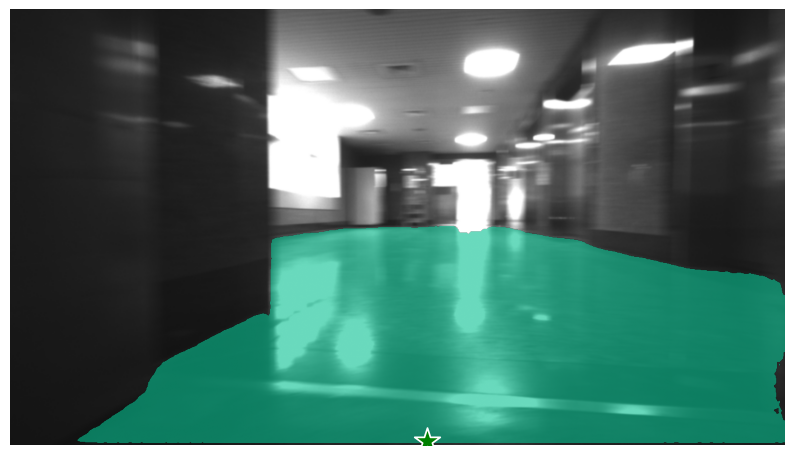

CPU RAM Free: 3.31GB | Used: 13.20GB | Util  23% | Total 62.63GB
GPU RAM Free: 1.26GB | Used: 22.36GB | Util  93% | Total 23.99GB
Took 8.169950723648071 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1723429944.pgm... 
Bounding Box Coordinate: (21.69757843017578, 401.01144790649414, 806.7631530761719, 707.2236728668213)


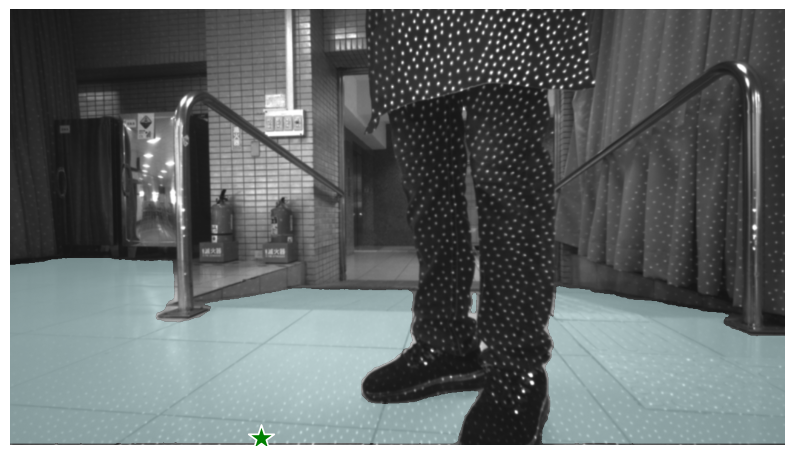

CPU RAM Free: 3.12GB | Used: 13.39GB | Util  23% | Total 62.63GB
GPU RAM Free: 1.26GB | Used: 22.36GB | Util  93% | Total 23.99GB
Took 8.092091798782349 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309925.pgm... 
Bounding Box Coordinate: (38.25237274169922, 350.1712703704834, 1280.0, 715.199146270752)


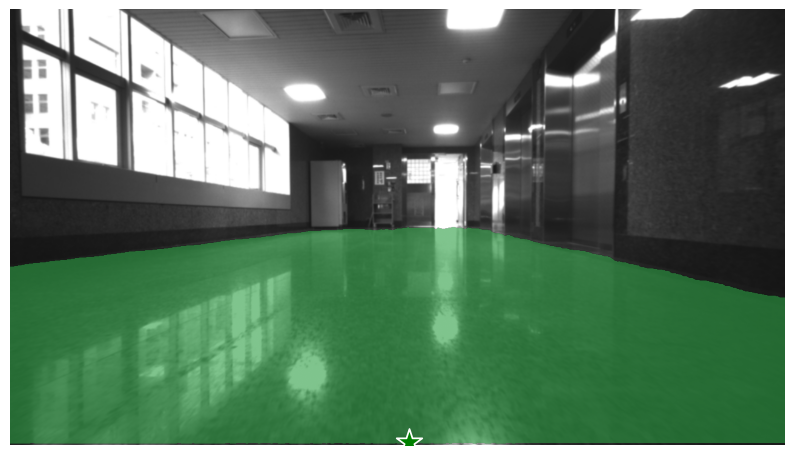

CPU RAM Free: 3.25GB | Used: 13.26GB | Util  23% | Total 62.63GB
GPU RAM Free: 1.26GB | Used: 22.36GB | Util  93% | Total 23.99GB
Took 8.182446002960205 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309890.pgm... 
Bounding Box Coordinate: (24.90936279296875, 413.5121726989746, 1118.9701080322266, 712.9802513122559)


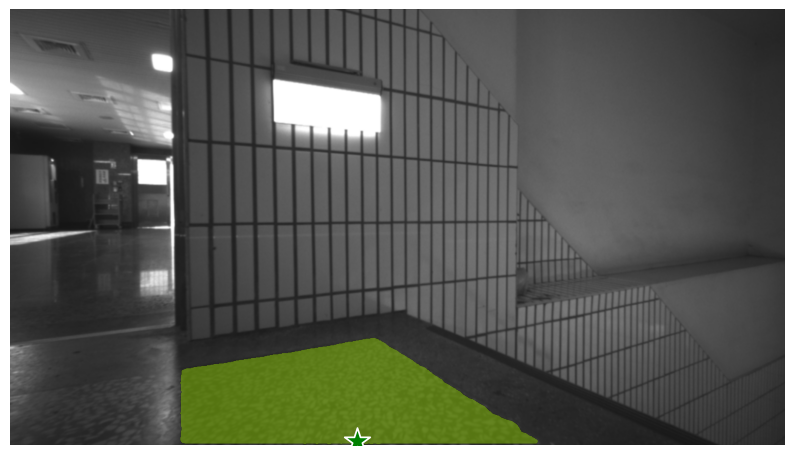

CPU RAM Free: 3.16GB | Used: 13.35GB | Util  23% | Total 62.63GB
GPU RAM Free: 1.26GB | Used: 22.36GB | Util  93% | Total 23.99GB
Took 8.160633325576782 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309882.pgm... 
Bounding Box Coordinate: (64.81548309326172, 401.6276264190674, 1253.2749938964844, 706.8743419647217)


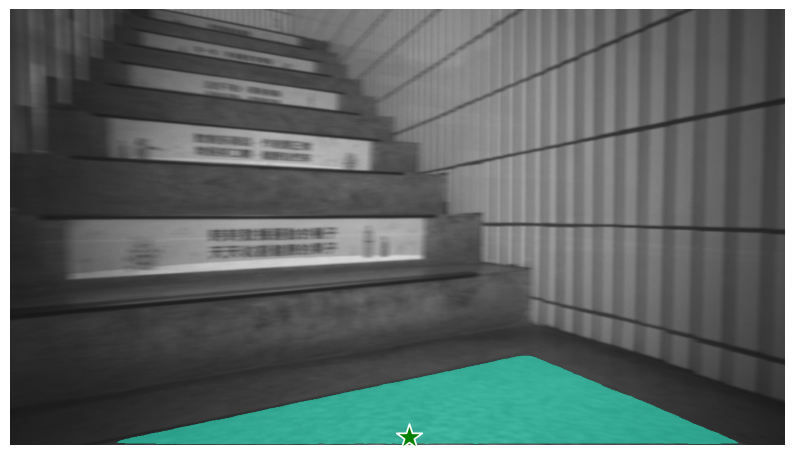

CPU RAM Free: 3.28GB | Used: 13.24GB | Util  23% | Total 62.63GB
GPU RAM Free: 1.26GB | Used: 22.36GB | Util  93% | Total 23.99GB
Took 8.235388278961182 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309918.pgm... 
Bounding Box Coordinate: (10.643959045410156, 335.7225966453552, 1280.0, 710.5654907226562)


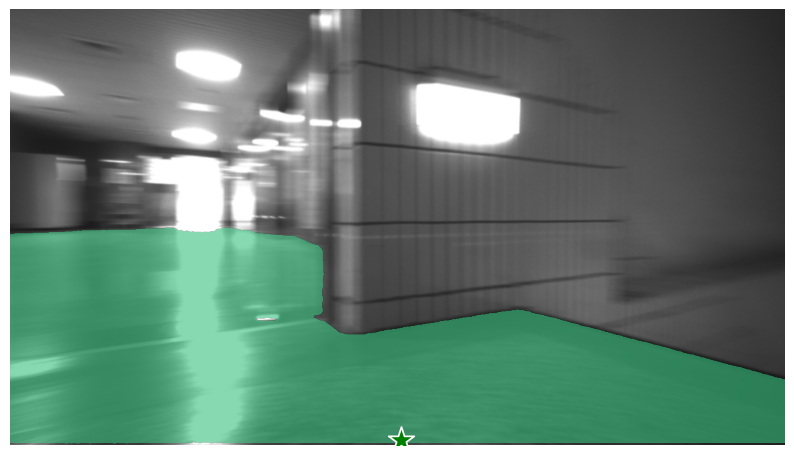

CPU RAM Free: 3.18GB | Used: 13.33GB | Util  23% | Total 62.63GB
GPU RAM Free: 1.26GB | Used: 22.36GB | Util  93% | Total 23.99GB
Took 8.207129716873169 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309930.pgm... 
Bounding Box Coordinate: (84.27154541015625, 325.9166121482849, 1271.8946838378906, 701.8801116943359)


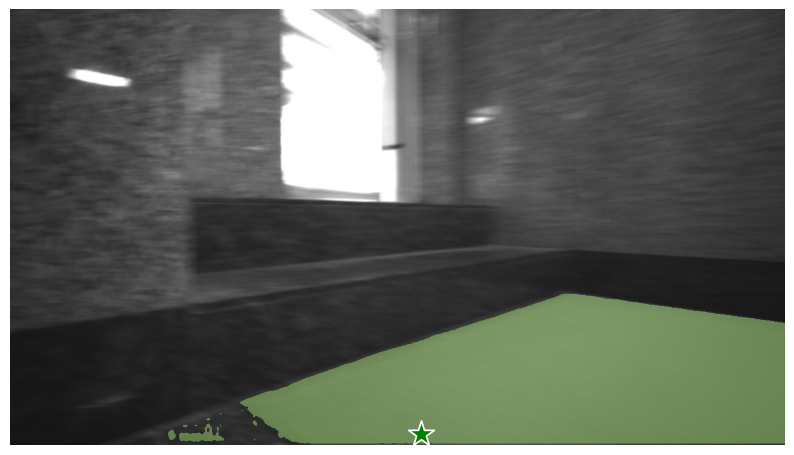

CPU RAM Free: 3.13GB | Used: 13.38GB | Util  23% | Total 62.63GB
GPU RAM Free: 1.26GB | Used: 22.36GB | Util  93% | Total 23.99GB
Took 8.151315212249756 secs to annotate
--------------------------------------------------

Running inference for ./images/test/0.png... 
Bounding Box Coordinate: (982.5604248046875, 393.74253273010254, 1241.2881469726562, 683.3473777770996)


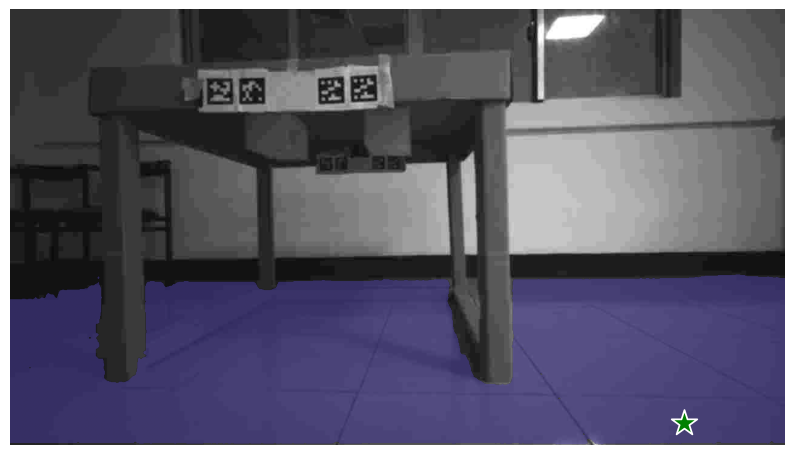

CPU RAM Free: 3.17GB | Used: 13.34GB | Util  23% | Total 62.63GB
GPU RAM Free: 1.26GB | Used: 22.36GB | Util  93% | Total 23.99GB
Took 8.164424419403076 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1723000215.pgm... 
Bounding Box Coordinate: (803.1465911865234, 459.0334224700928, 1265.6208038330078, 708.8535976409912)


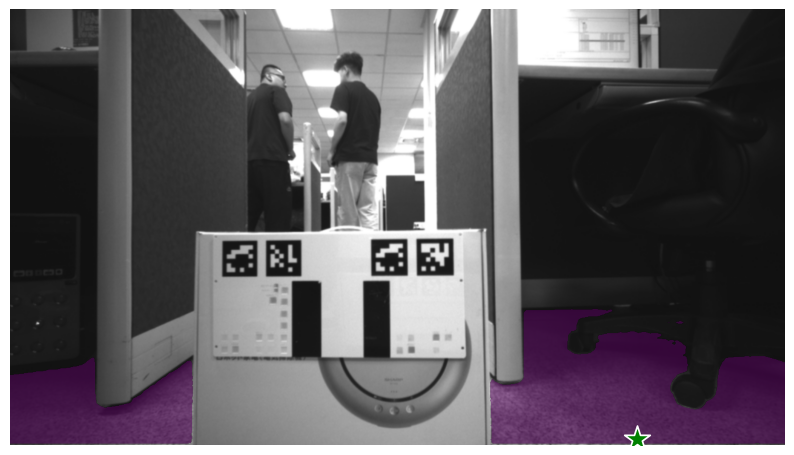

CPU RAM Free: 3.14GB | Used: 13.38GB | Util  23% | Total 62.63GB
GPU RAM Free: 1.26GB | Used: 22.36GB | Util  93% | Total 23.99GB
Took 8.24694013595581 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1723000219.pgm... 
Bounding Box Coordinate: (777.926025390625, 462.08152770996094, 1269.2568969726562, 709.6167182922363)


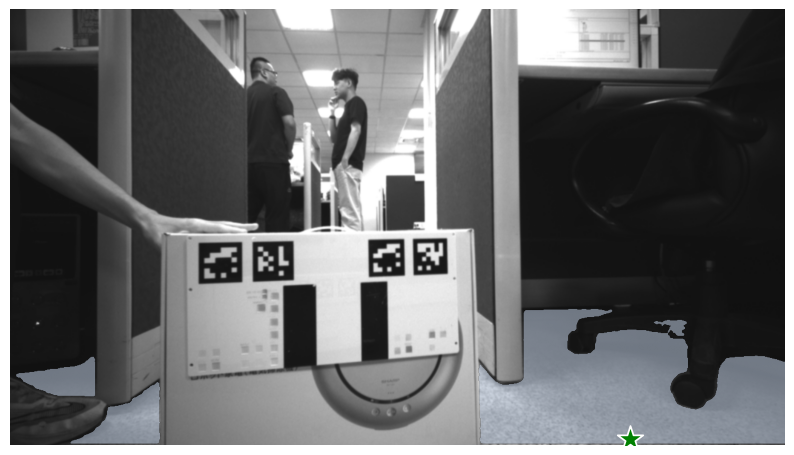

CPU RAM Free: 3.33GB | Used: 13.19GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.27GB | Used: 22.36GB | Util  93% | Total 23.99GB
Took 8.129760026931763 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309884.pgm... 
Bounding Box Coordinate: (21.17168426513672, 410.52899837493896, 1262.1656799316406, 713.1031179428101)


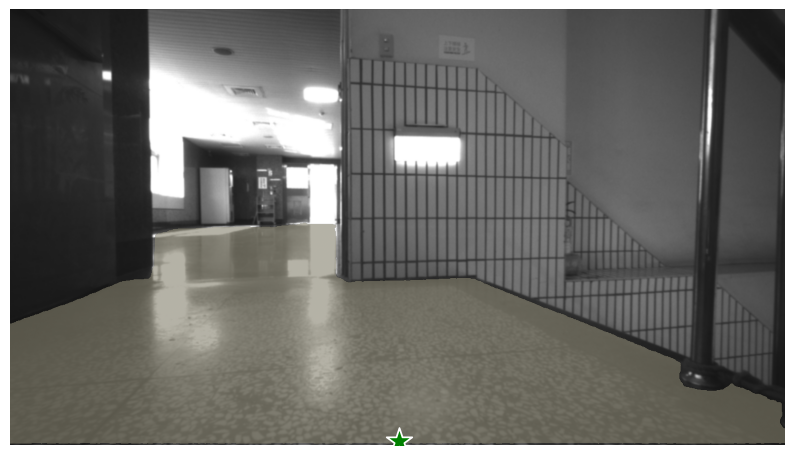

CPU RAM Free: 3.22GB | Used: 13.29GB | Util  23% | Total 62.63GB
GPU RAM Free: 1.27GB | Used: 22.36GB | Util  93% | Total 23.99GB
Took 8.060925483703613 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309919.pgm... 
Bounding Box Coordinate: (45.48206329345703, 354.6543574333191, 1266.7886352539062, 715.675163269043)


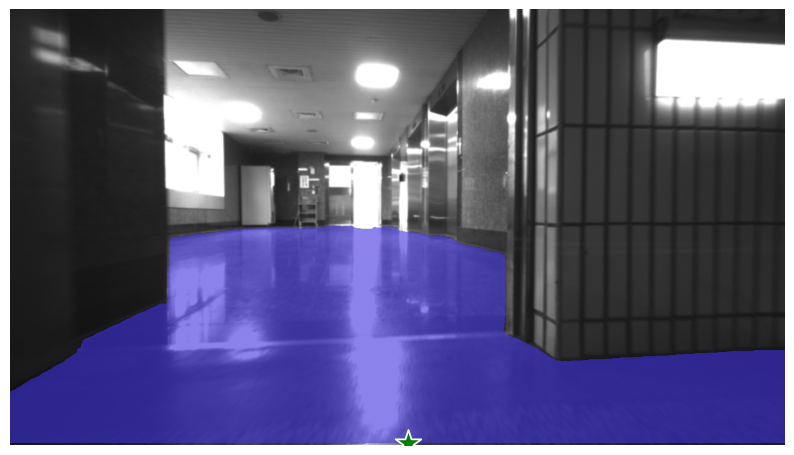

CPU RAM Free: 3.20GB | Used: 13.32GB | Util  23% | Total 62.63GB
GPU RAM Free: 1.27GB | Used: 22.36GB | Util  93% | Total 23.99GB
Took 8.055867910385132 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1723000218.pgm... 
Bounding Box Coordinate: (804.0418243408203, 452.17872619628906, 1266.5938568115234, 708.6700916290283)


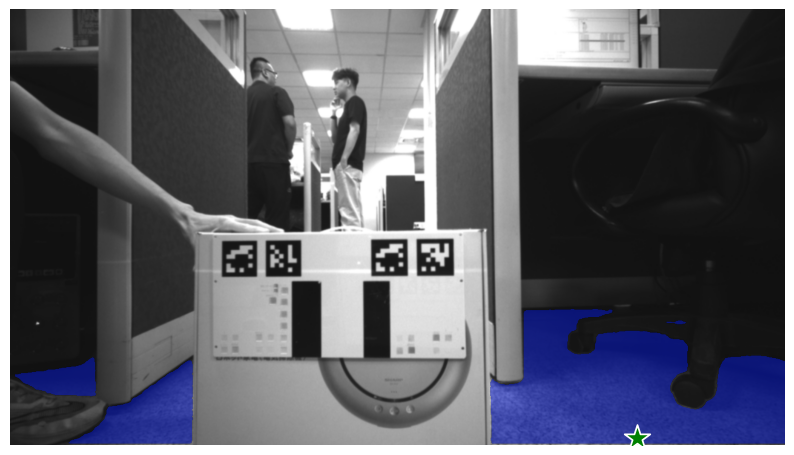

CPU RAM Free: 3.15GB | Used: 13.36GB | Util  23% | Total 62.63GB
GPU RAM Free: 1.27GB | Used: 22.36GB | Util  93% | Total 23.99GB
Took 8.226221561431885 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309941.pgm... 
Bounding Box Coordinate: (132.06558227539062, 3.4456515312194824, 1189.3263244628906, 717.5322818756104)


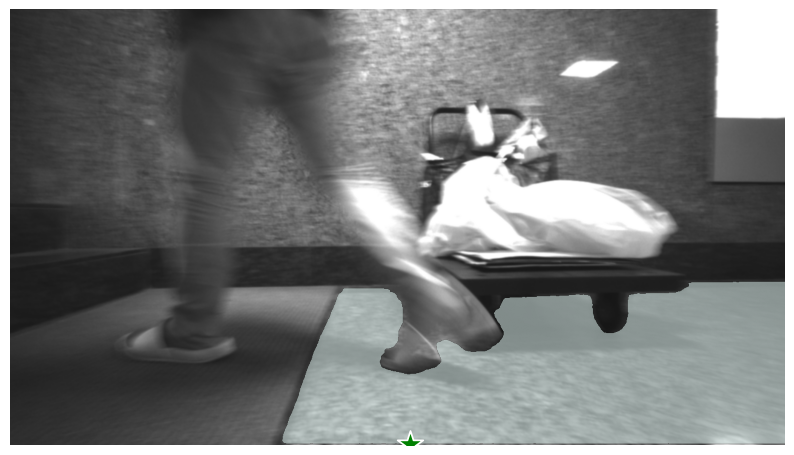

CPU RAM Free: 3.16GB | Used: 13.36GB | Util  23% | Total 62.63GB
GPU RAM Free: 1.27GB | Used: 22.36GB | Util  93% | Total 23.99GB
Took 8.257078409194946 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309892.pgm... 
Bounding Box Coordinate: (78.3291244506836, 501.1647033691406, 827.7896118164062, 715.31081199646)


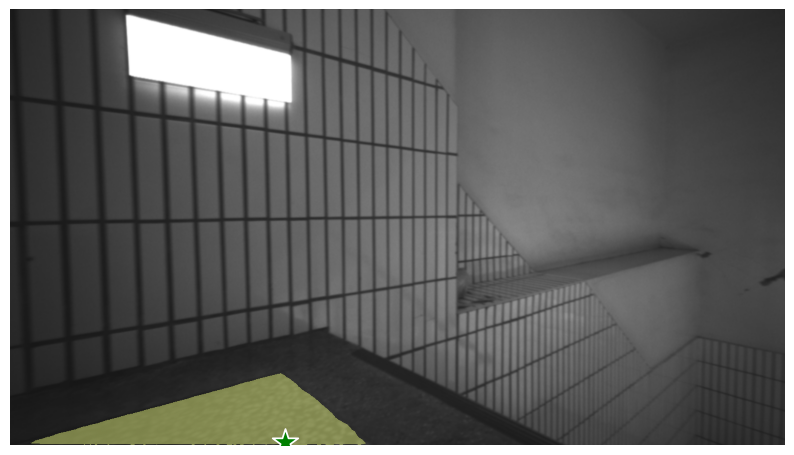

CPU RAM Free: 3.18GB | Used: 13.34GB | Util  23% | Total 62.63GB
GPU RAM Free: 1.27GB | Used: 22.36GB | Util  93% | Total 23.99GB
Took 8.240710020065308 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309914.pgm... 
Bounding Box Coordinate: (1.33331298828125, 405.5372142791748, 1259.6621704101562, 708.5620307922363)


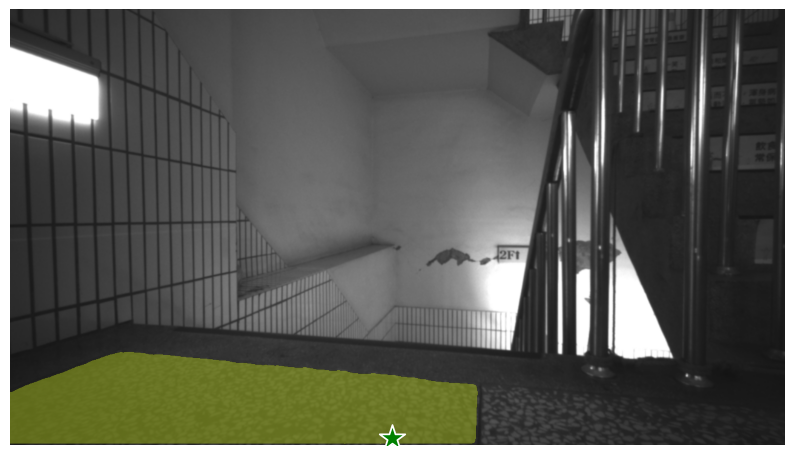

CPU RAM Free: 3.09GB | Used: 13.43GB | Util  23% | Total 62.63GB
GPU RAM Free: 1.27GB | Used: 22.36GB | Util  93% | Total 23.99GB
Took 8.110172033309937 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309868.pgm... 
Bounding Box Coordinate: (11.126327514648438, 190.9691834449768, 1263.2952117919922, 683.115291595459)


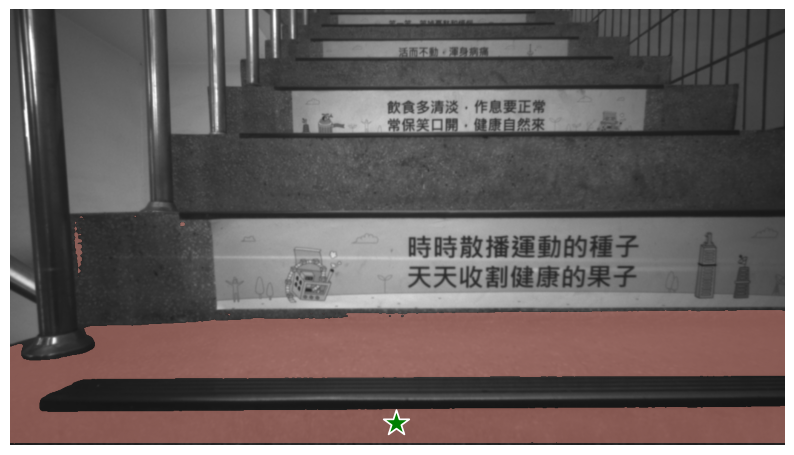

CPU RAM Free: 3.17GB | Used: 13.34GB | Util  23% | Total 62.63GB
GPU RAM Free: 1.27GB | Used: 22.36GB | Util  93% | Total 23.99GB
Took 8.198460340499878 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309854.pgm... 
Bounding Box Coordinate: (60.98106384277344, 542.149715423584, 1267.7074432373047, 716.9401359558105)


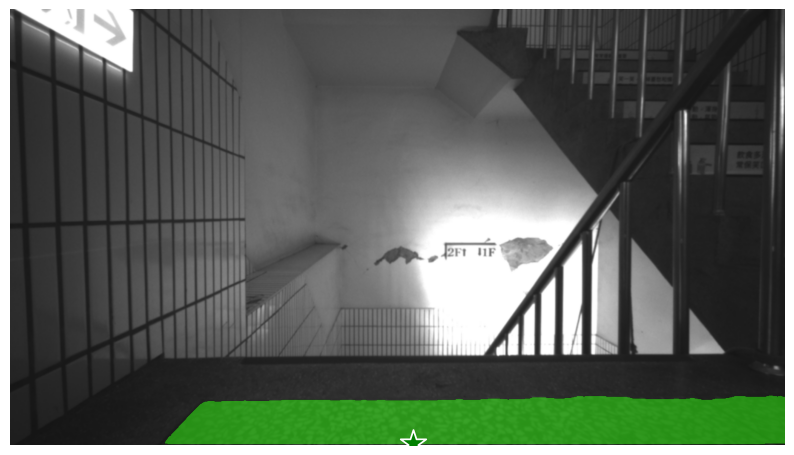

CPU RAM Free: 3.58GB | Used: 13.31GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.27GB | Used: 22.36GB | Util  93% | Total 23.99GB
Took 8.137514114379883 secs to annotate
--------------------------------------------------

Running inference for ./images/test/1722163213@-0.37,0.58,2.27.jpg... 
Bounding Box Coordinate: (17.198538780212402, 643.590087890625, 708.7358808517456, 1241.561279296875)


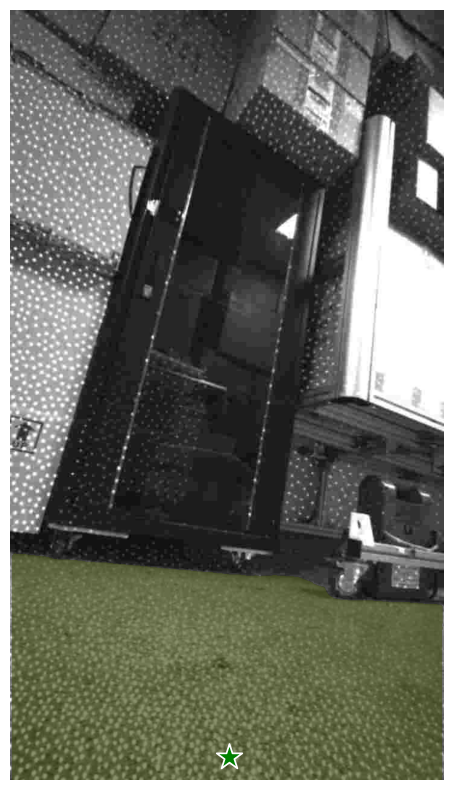

CPU RAM Free: 3.58GB | Used: 13.31GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.27GB | Used: 22.36GB | Util  93% | Total 23.99GB
Took 8.459416627883911 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309848.pgm... 
Bounding Box Coordinate: (19.502334594726562, 43.065805435180664, 1270.4158782958984, 705.7672119140625)


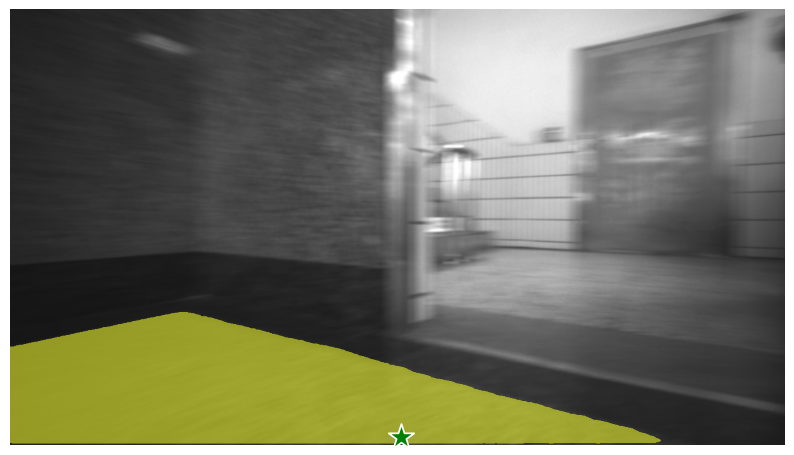

CPU RAM Free: 3.58GB | Used: 13.31GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.27GB | Used: 22.36GB | Util  93% | Total 23.99GB
Took 8.402698516845703 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724308639.pgm... 
Bounding Box Coordinate: (54.01935577392578, 20.08777141571045, 1279.3460083007812, 720.0)


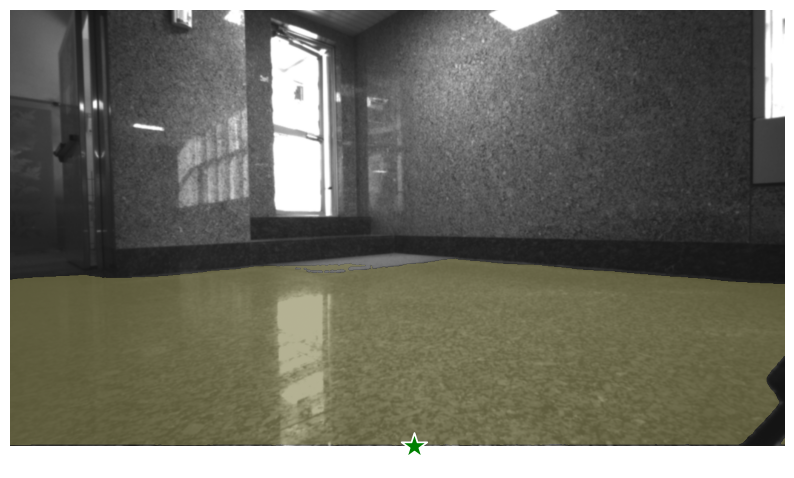

CPU RAM Free: 3.51GB | Used: 13.38GB | Util  23% | Total 62.63GB
GPU RAM Free: 1.27GB | Used: 22.36GB | Util  93% | Total 23.99GB
Took 8.323334455490112 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309905.pgm... 
Bounding Box Coordinate: (0.0, 498.1492567062378, 1218.3968353271484, 709.7815561294556)


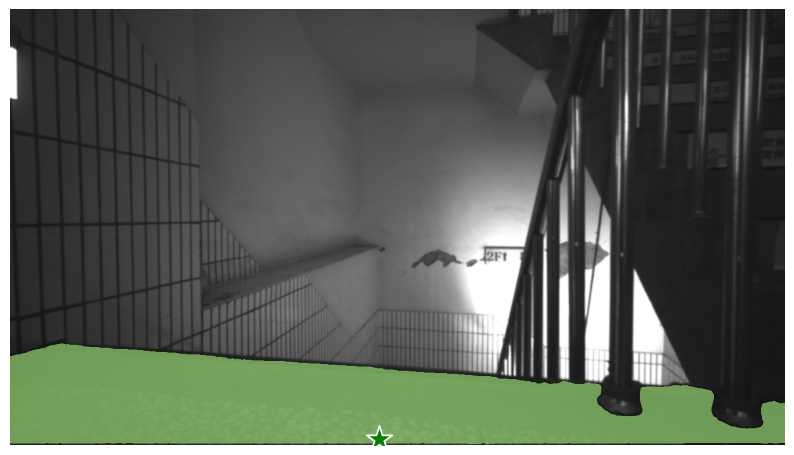

CPU RAM Free: 3.55GB | Used: 13.33GB | Util  22% | Total 62.63GB
GPU RAM Free: 1.27GB | Used: 22.36GB | Util  93% | Total 23.99GB
Took 8.207772254943848 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309874.pgm... 
Bounding Box Coordinate: (44.1015625, 193.40643167495728, 1246.4796447753906, 685.913028717041)


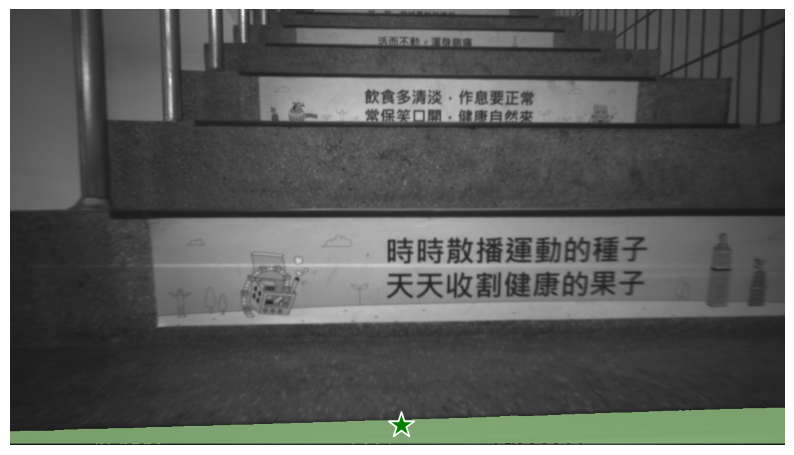

CPU RAM Free: 3.51GB | Used: 13.38GB | Util  23% | Total 62.63GB
GPU RAM Free: 1.27GB | Used: 22.36GB | Util  93% | Total 23.99GB
Took 8.333503723144531 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309942.pgm... 
Bounding Box Coordinate: (339.66121673583984, 222.9175329208374, 1259.6188354492188, 701.7902898788452)


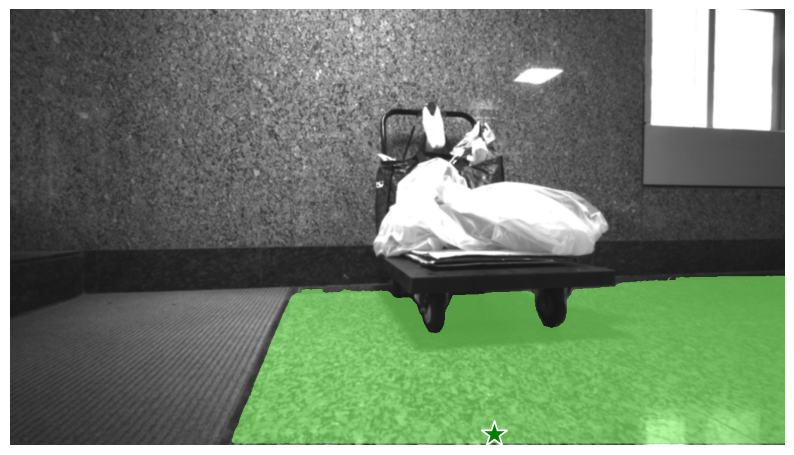

CPU RAM Free: 3.50GB | Used: 13.39GB | Util  23% | Total 62.63GB
GPU RAM Free: 1.27GB | Used: 22.36GB | Util  93% | Total 23.99GB
Took 8.369930982589722 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309915.pgm... 
Bounding Box Coordinate: (25.61054229736328, 355.4968500137329, 1224.6308898925781, 706.7247819900513)


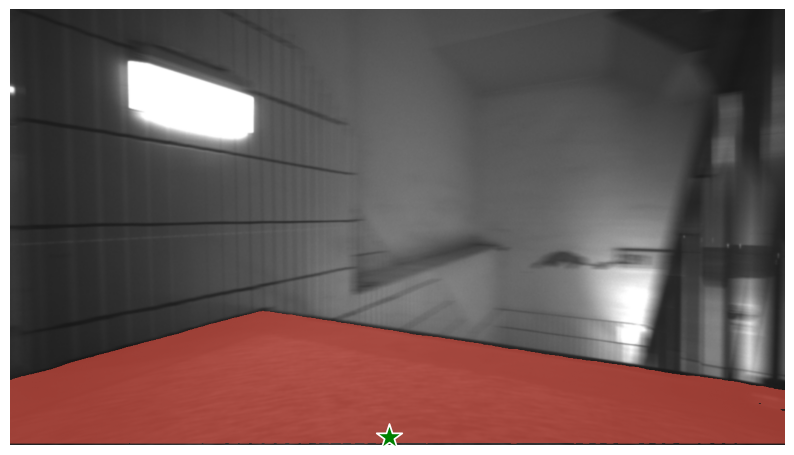

CPU RAM Free: 3.52GB | Used: 13.37GB | Util  23% | Total 62.63GB
GPU RAM Free: 1.27GB | Used: 22.36GB | Util  93% | Total 23.99GB
Took 8.525480031967163 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309926.pgm... 
Bounding Box Coordinate: (0.23799896240234375, 352.02463388442993, 1276.8484497070312, 716.9635677337646)


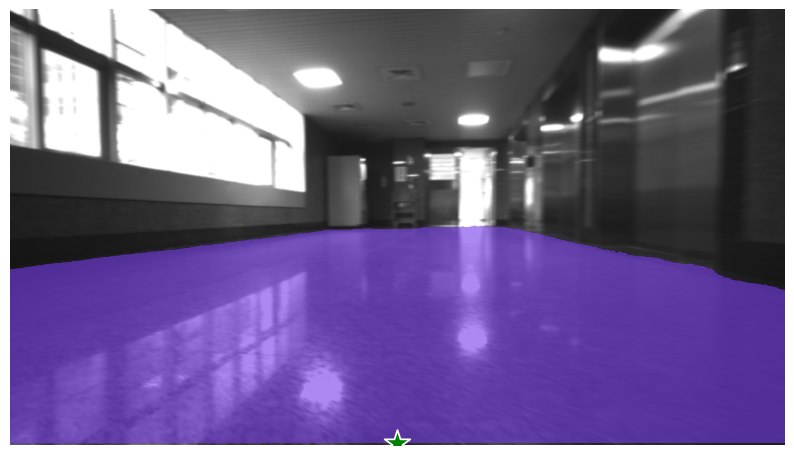

CPU RAM Free: 3.44GB | Used: 13.45GB | Util  23% | Total 62.63GB
GPU RAM Free: 1.27GB | Used: 22.36GB | Util  93% | Total 23.99GB
Took 8.244710445404053 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1724309867.pgm... 
Bounding Box Coordinate: (55.37559509277344, 369.68384742736816, 1269.0970611572266, 699.3422698974609)


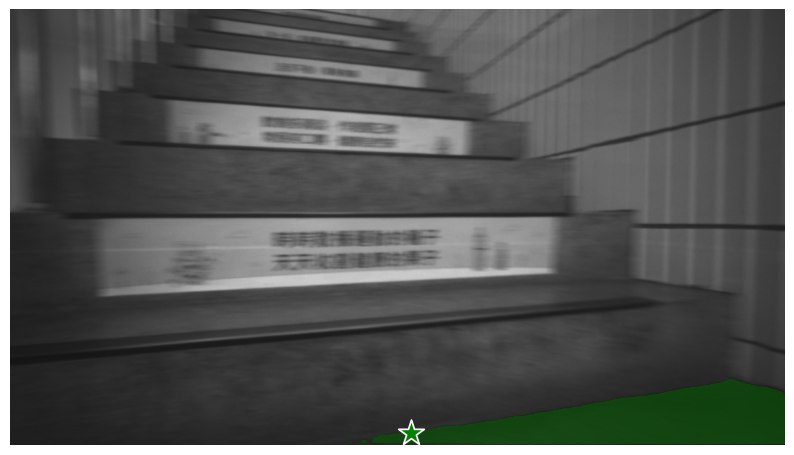

CPU RAM Free: 3.53GB | Used: 13.35GB | Util  23% | Total 62.63GB
GPU RAM Free: 1.27GB | Used: 22.36GB | Util  93% | Total 23.99GB
Took 8.528368711471558 secs to annotate
--------------------------------------------------

Running inference for ./images/test/img1723000214.pgm... 
Bounding Box Coordinate: (804.2823791503906, 454.35633659362793, 1266.3046264648438, 708.9197731018066)


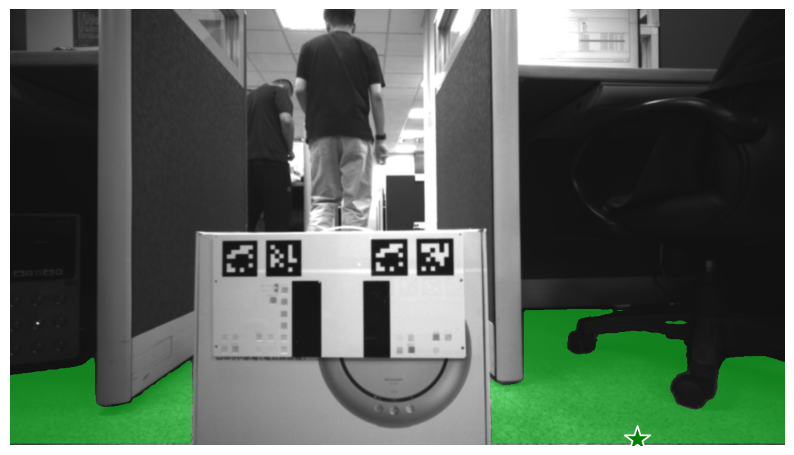

CPU RAM Free: 3.53GB | Used: 13.36GB | Util  23% | Total 62.63GB
GPU RAM Free: 1.27GB | Used: 22.36GB | Util  93% | Total 23.99GB
Took 8.446449995040894 secs to annotate
--------------------------------------------------

Done


In [4]:
for idx, image_path in enumerate(IMAGE_PATHS):
    print('Running inference for {}... '.format(image_path))

    start = time.time()
    image_np = load_image_into_numpy_array(image_path)
    if image_path.endswith('.jpg'):
        image_np = cv2.rotate(image_np, cv2.ROTATE_90_COUNTERCLOCKWISE)

    input_tensor = tf.convert_to_tensor(image_np)
    input_tensor = input_tensor[tf.newaxis, ...]

    detections = detect_fn(input_tensor)

    image_np_with_detections = image_np.copy()

    detection_boxes = tf.squeeze(detections['detection_boxes'], [0])
    detection_masks = tf.squeeze(detections['detection_masks'], [0])

    real_num_detection = tf.cast(detections['num_detections'][0], tf.int32)
    detection_boxes = tf.slice(detection_boxes, [0, 0],
                               [real_num_detection, -1])
    detection_masks = tf.slice(detection_masks, [0, 0, 0],
                               [real_num_detection, -1, -1])
    detection_masks_reframed = utils_ops.reframe_box_masks_to_image_masks(
        detection_masks, detection_boxes, image_np.shape[0], image_np.shape[1])
    detection_masks_reframed = tf.cast(
        tf.greater(detection_masks_reframed, 0.5), tf.uint8)
    
    detections['detection_masks'] = tf.expand_dims(detection_masks_reframed, 0)

    detections['num_detections'] = int(detections['num_detections'][0])
    detections['detection_classes'] = detections['detection_classes'][0].numpy().astype(np.uint8)
    detections['detection_boxes'] = detections['detection_boxes'][0].numpy()
    detections['detection_scores'] = detections['detection_scores'][0].numpy()
    detections['detection_masks'] = detections['detection_masks'][0].numpy()

    image = Image.fromarray(np.uint8(image_np_with_detections))

    width, height = image.size
    (ymin, xmin, ymax, xmax) = detections['detection_boxes'][0]
    x_min, x_max, y_min, y_max = xmin * width, xmax * width, ymin * height, ymax * height # Boundig Box Coordinate
    
    center_x = (x_min + x_max) / 2
    center_y = (y_min + y_max) / 2
    point = np.array([[center_x, y_max]])
    label = np.array([1])

    if DEBUG:
        viz_utils.visualize_boxes_and_labels_on_image_array(
            image_np_with_detections,
            detections['detection_boxes'],
            detections['detection_classes'],
            detections['detection_scores'],
            category_index,
            instance_masks=detections.get('detection_masks'),
            use_normalized_coordinates=True,
            max_boxes_to_draw=200,
            min_score_thresh=.30)
        
    print(f"Bounding Box Coordinate: ({x_min}, {y_min}, {x_max}, {y_max})")

    predictor.set_image(image_np)
    masks, scores, logits = predictor.predict(
        point_coords = point,
        point_labels = label,
        multimask_output = True
    )
    max_idx = np.argmax(scores) 

    end = time.time()

    plt.figure(figsize=(10, 10))
    plt.imshow(image_np)
    show_mask(masks[max_idx], plt.gca())
    show_points(point, label, plt.gca())
    plt.axis('off')
    plt.show()
    
    if DEBUG:
        output_path = f'images/test_annotated/{idx}.png'
        cv2.imwrite(output_path, image_np_with_detections)  
        print(f"Save as {output_path}")

    cpu_usage, gpu_usage= log_hardware_usage()
    print(cpu_usage)
    print(gpu_usage)
    print(f"Took {end - start} secs to annotate")
    print('-' * 50, end='\n\n')

print("Done")